## IGO17483 AT1401 3D KP Slc4a11-MCD Lenti-iRFP670-Gluc-Flex(tagBFP) (not activated)
7/10/25 - Data generated from IV transplanted cells - Vehicle & DT treated; data submitted by CHP/EB on 6/25/2025; analyzed by JC 7/10/2025

8/26/2025 - Rerun with latest libraries to ensure consistency

Analyze global run on cellranger v8 data and create h5_ad files for further analysis - w/o introns

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib

from pathlib import Path
import anndata
from joblib import dump, load

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
Path("./figures/umap_density_Group_figures").mkdir(parents=True, exist_ok=True)
Path("./figures/umapfigures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [4]:
results_file = 'write/IGO17483_Vehicle_DT.h5ad'  # the file that will store the analysis results

In [5]:
adata1 = anndata.read('write/allmice-tumor-IGO17483-Vehicle.h5ad')
adata2 = anndata.read('write/allmice-tumor-IGO17483-DT.h5ad')

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [6]:
adata = adata1.concatenate(adata2,join='outer')
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/2252045446.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adata1.concatenate(adata2,join='outer')


In [7]:
# Convert all columns in adata.raw.var to string, to make this h5ad compatible
for col in adata.var.columns:
    series = adata.var[col]
    if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
        adata.var[col] = series.astype(str)

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/2496206387.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/2496206387.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/2496206387.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/

In [8]:
adata.write_h5ad('write/allmice-tumor-IGO17483_vehicle_DT.h5ad', compression='gzip')

## Set highly variable genes

In [9]:
sc.pp.highly_variable_genes(adata, batch_key='batch')

extracting highly variable genes
    finished (0:00:08)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [10]:
adata.var.highly_variable = adata.var.highly_variable_intersection

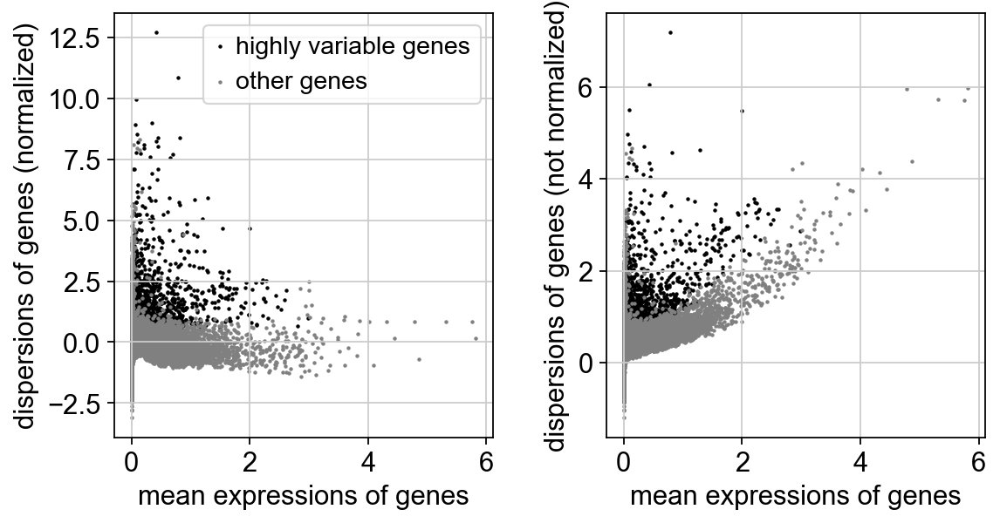

In [11]:
sc.pl.highly_variable_genes(adata)

In [12]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['iRFP670'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/320926811.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/3209268

In [13]:
adata.raw = adata

In [14]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [15]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


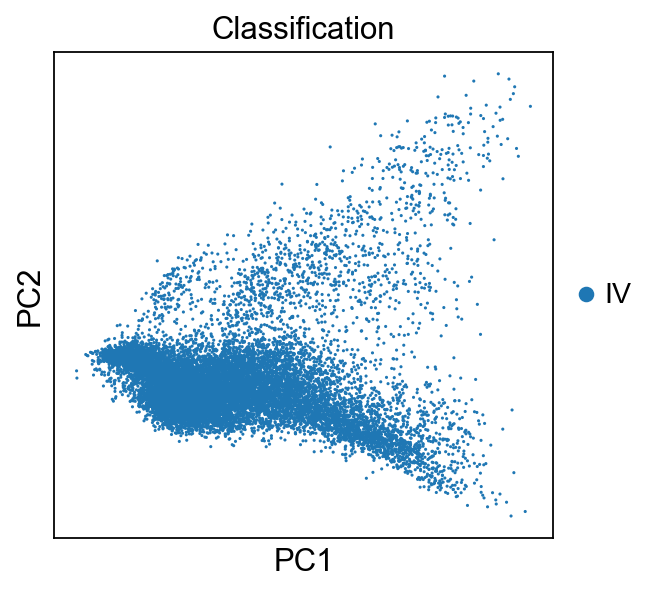

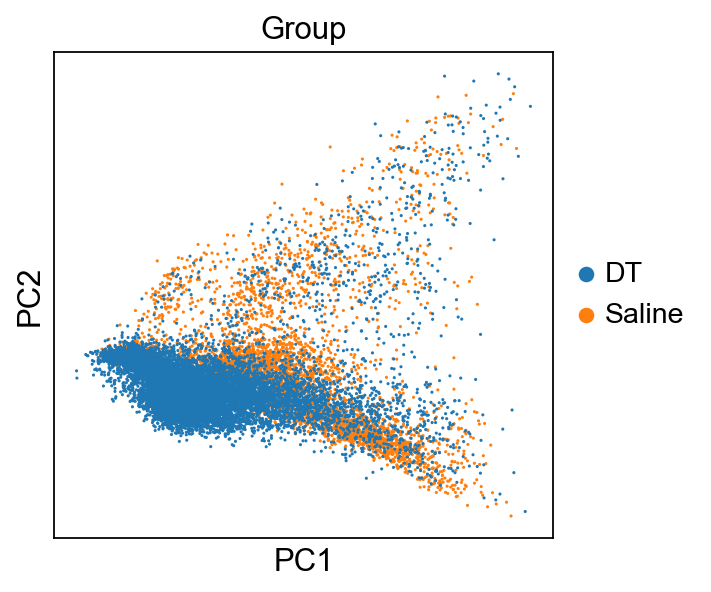

In [16]:
#sc.pl.pca(adata, color='leiden',dimensions=[(0,1)])
sc.pl.pca(adata, color='Classification',dimensions=[(0,1)])
sc.pl.pca(adata, color='Group',dimensions=[(0,1)])

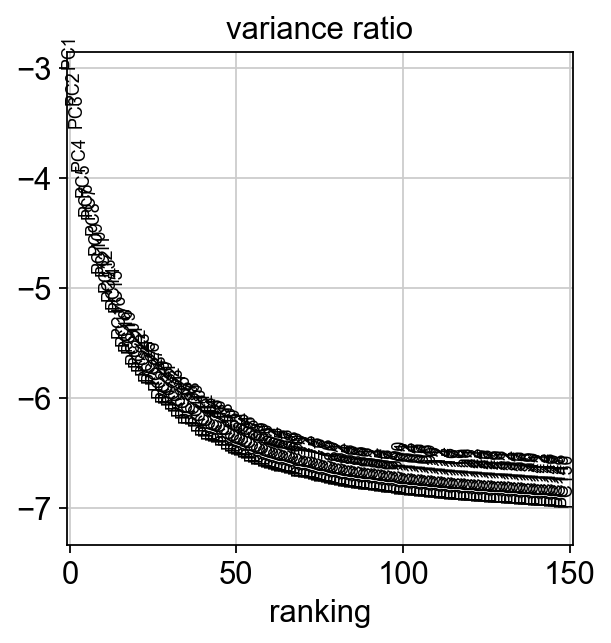

In [17]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

## Computing the neighborhood graph

In [18]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=30)              

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:25)


## Embedding the neighborhood graph

In [19]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:09)


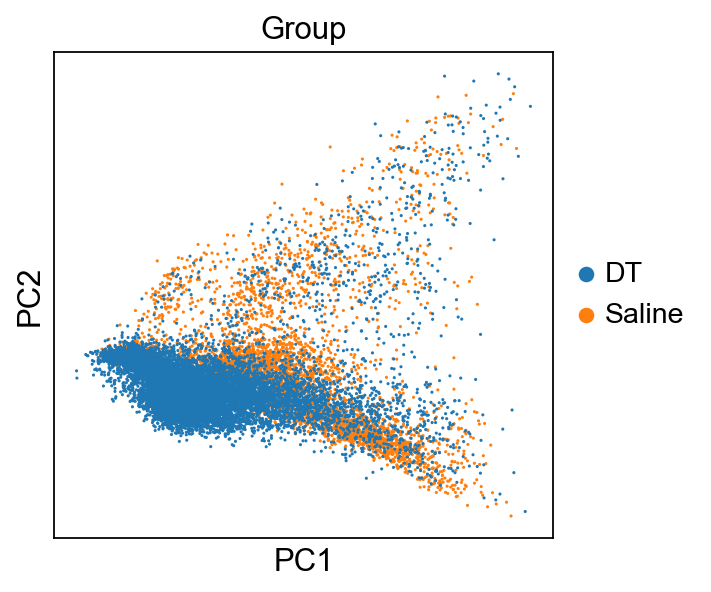

In [20]:
#sc.pl.pca(adata, color='leiden',dimensions=[(0,1)])
sc.pl.pca(adata, color='Group',dimensions=[(0,1)])

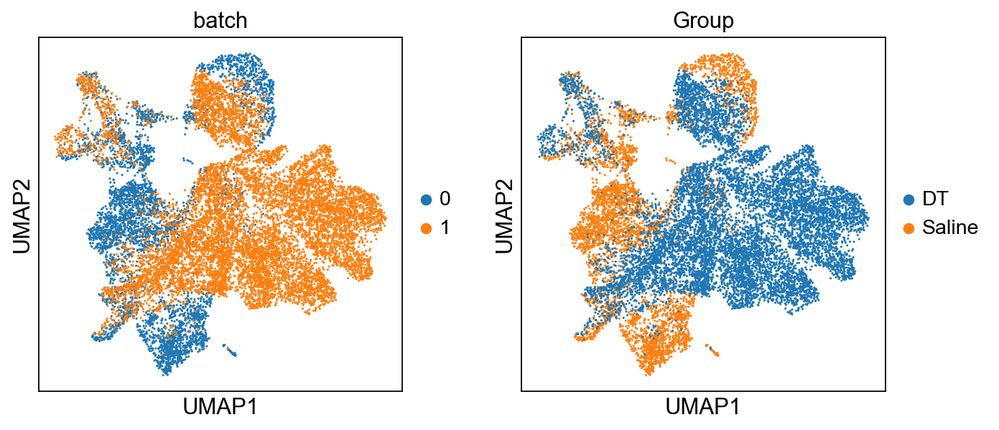

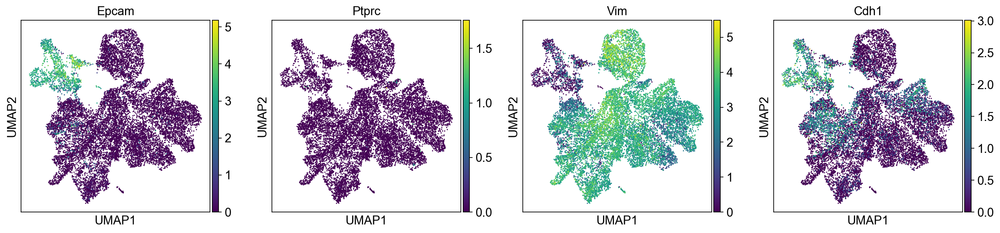

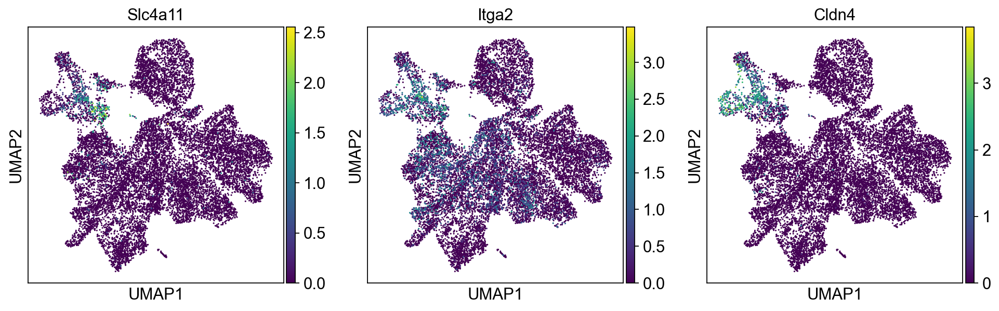

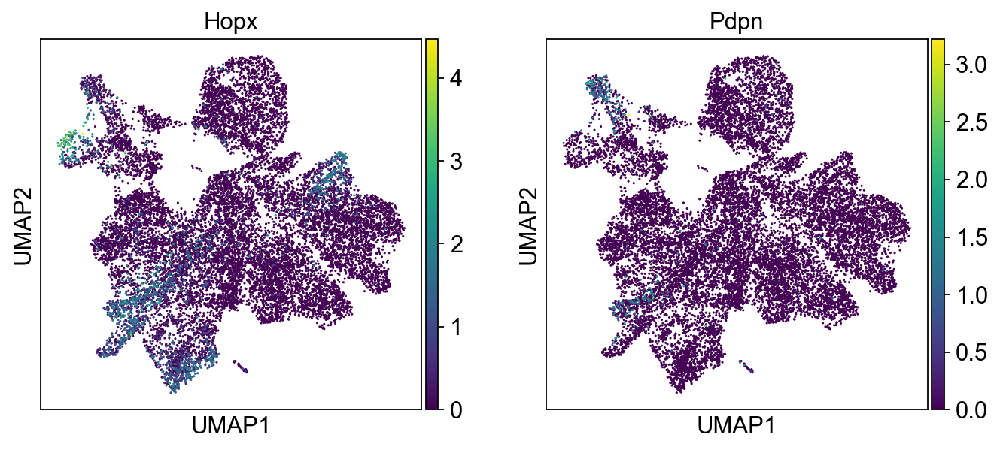

In [21]:
sc.pl.umap(adata, color=['batch','Group',])
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',])
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) 
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])

running Leiden clustering


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/1681192863.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=.3)


    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


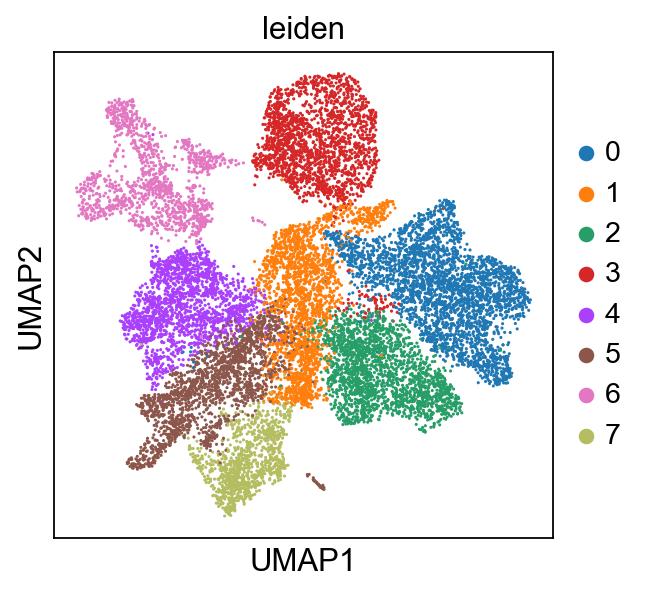

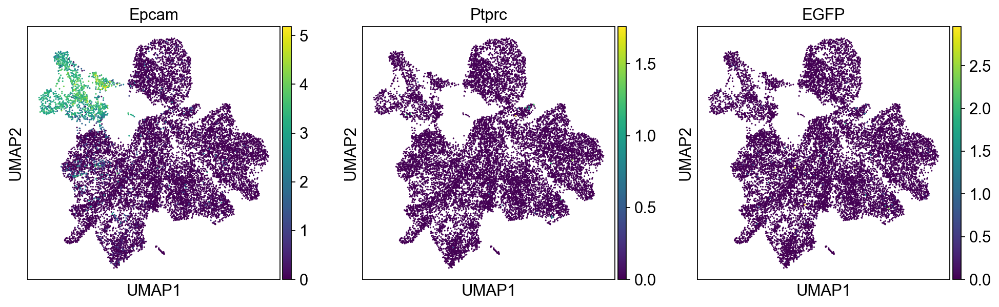

In [22]:
sc.tl.leiden(adata, resolution=.3)
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['Epcam','Ptprc','EGFP'])

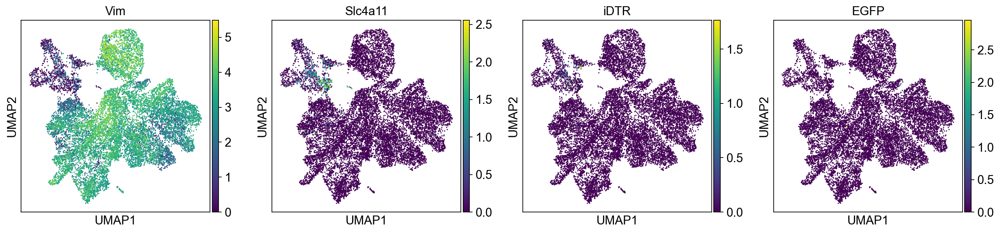

In [23]:
sc.pl.umap(adata, color=['Vim', 'Slc4a11', 'iDTR', 'EGFP']) #'Sox11', 

## Define scoring Functions

In [24]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [25]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [26]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    2294 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    2201 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    2190 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    2196 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1793 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Rps2-ps13', 'Fam46c', 'Gm6139', 'Gm10179', 'Gm5864'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    2092 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: adde

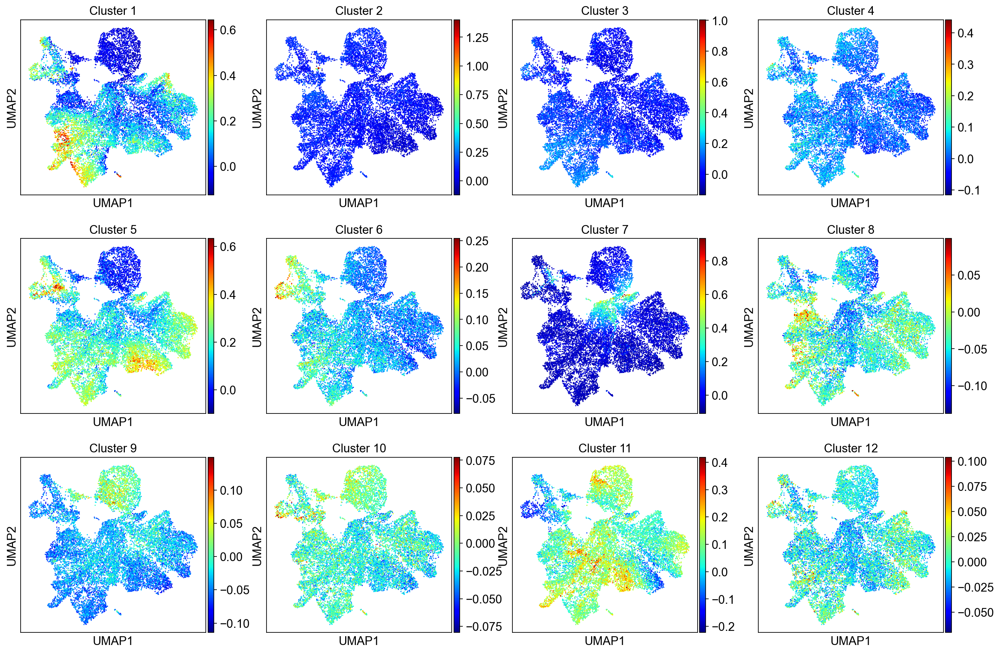

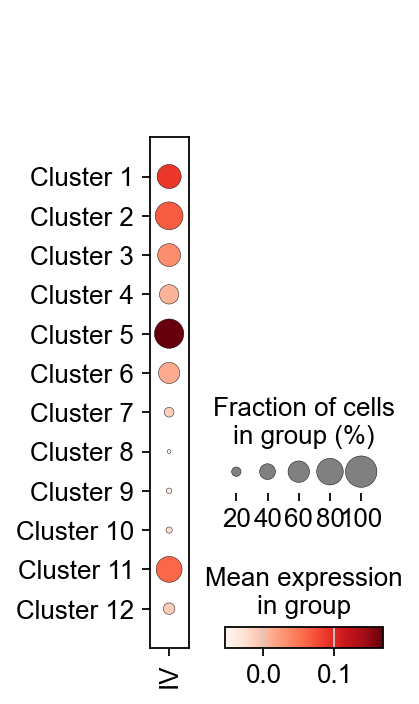

In [27]:
scoreAndPlot(adata, numgenes=100)

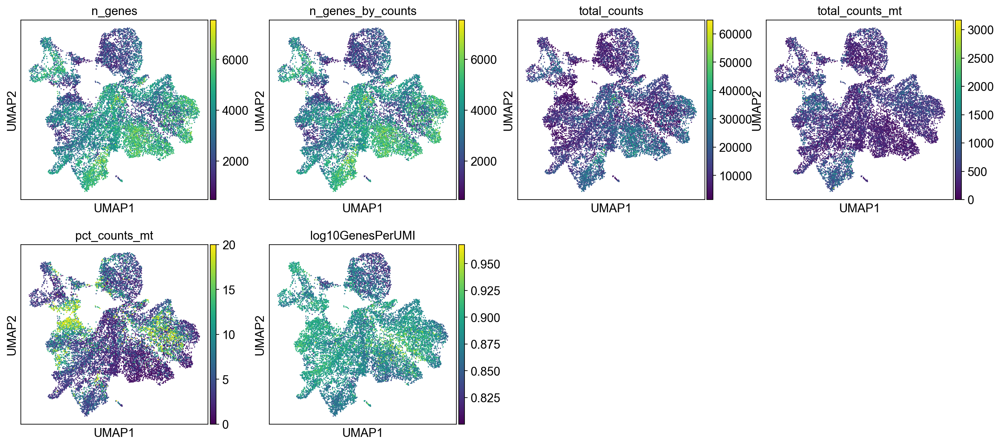

In [28]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

## Clustering the neighborhood graph

running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


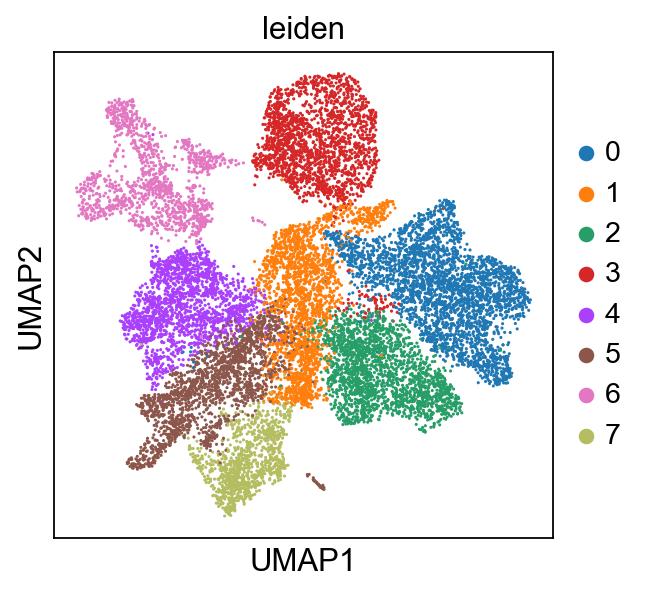

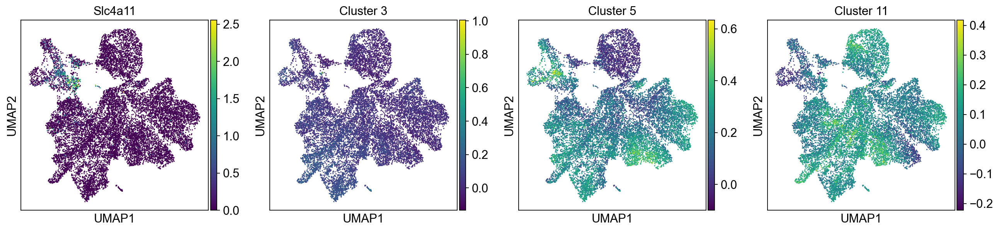

In [29]:
sc.tl.leiden(adata, resolution=.3)
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['Slc4a11','Cluster 3','Cluster 5','Cluster 11'])

In [30]:
adata.obs[['Classification']].value_counts(sort=False)

Classification
IV                15226
Name: count, dtype: int64

## Logistic Regression

In [31]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../../common_files/genes.joblib')

In [32]:
adata_log = adata[:,adata.var.index.isin(names)]

In [33]:
adata_names = [x for x in adata_log.var.index]

In [34]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [35]:
smartseq = anndata.read('../../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [36]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [37]:
names = [x for x in names_adata.var.index]

In [38]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1264: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [39]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[142,   5,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  8,  69,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  0,   1,   0,  68,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 177,   2,   0,   4,   0,   1,   0,   1],
       [  0,   0,   0,   0,   0,  34,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  14,   1,   0,   0,   0,   0],
       [  0,   0,   1,   2,   1,   0,   0, 138,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   3,   0,   0,   3,   0,  54,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   0,   0,   0,  42]])

Text(0.5, 295.64444444444445, 'Predicted label')

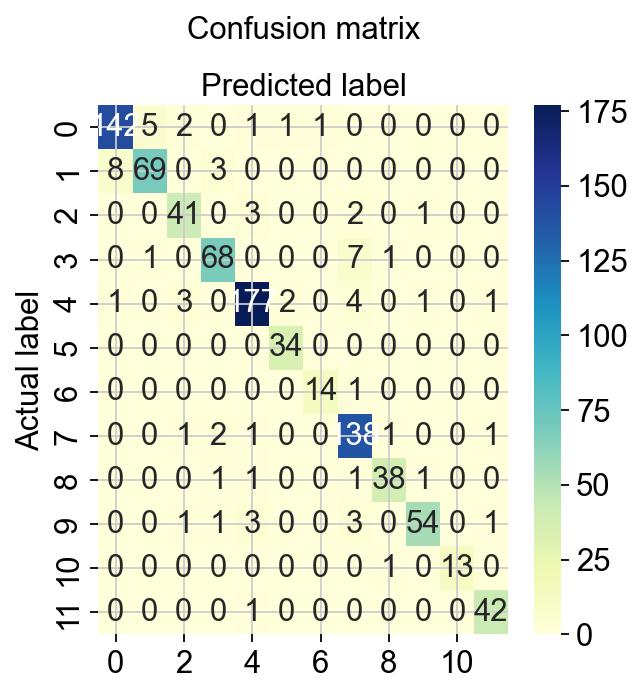

In [40]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [41]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.94      0.93      0.94       152
           2       0.92      0.86      0.89        80
           3       0.85      0.87      0.86        47
           4       0.91      0.88      0.89        77
           5       0.95      0.94      0.94       189
           6       0.92      1.00      0.96        34
           7       0.93      0.93      0.93        15
           8       0.88      0.96      0.92       144
           9       0.93      0.90      0.92        42
          10       0.95      0.86      0.90        63
          11       1.00      0.93      0.96        14
          12       0.93      0.98      0.95        43

    accuracy                           0.92       900
   macro avg       0.93      0.92      0.92       900
weighted avg       0.92      0.92      0.92       900



In [42]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [43]:
label_binarizer.classes_

array(['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11',
       '12'], dtype='<U2')

In [44]:
class_of_interest = '05'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

4

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/sklearn/utils/_plotting.py:175: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


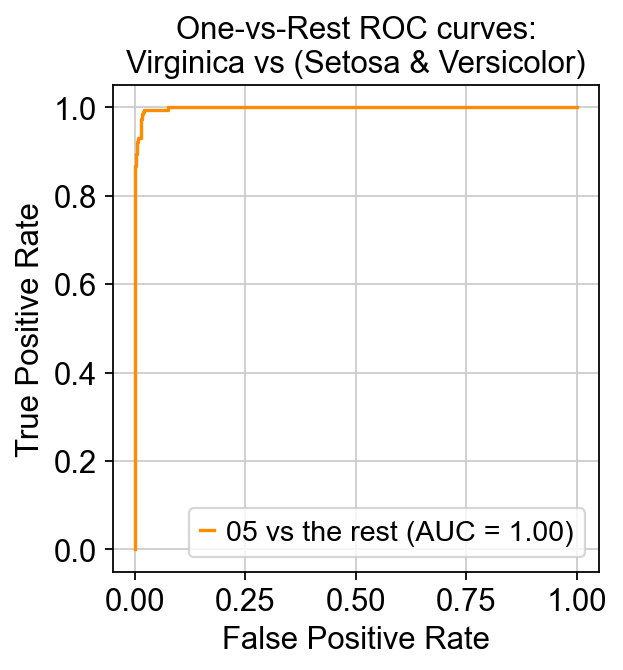

In [45]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [46]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [47]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [48]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.270397e-08,9.467331e-05,8.921756e-02,2.212687e-02,1.304932e-06,4.004669e-05,3.735587e-04,8.875021e-01,2.548379e-06,2.454932e-05,2.050328e-05,5.963110e-04,0.887502,0
1,01,01,9.999885e-01,2.859365e-07,1.381641e-08,9.536085e-08,1.231636e-07,1.159864e-06,9.721035e-06,3.809905e-10,2.553677e-09,7.470115e-09,1.237477e-07,8.451397e-09,0.999988,1
2,08,08,4.517405e-09,2.828594e-07,3.774383e-07,2.841567e-06,7.801152e-06,9.695836e-07,3.955003e-05,9.998566e-01,1.048975e-05,7.429985e-05,6.392597e-06,4.309108e-07,0.999857,1
3,05,10,4.324968e-08,7.384018e-06,2.964107e-05,4.133599e-07,5.589098e-01,7.228181e-04,7.220522e-05,3.293643e-05,3.180928e-04,4.388957e-01,7.860405e-05,9.323386e-04,0.558910,0
4,08,08,9.248971e-08,5.462277e-07,8.883585e-08,6.963311e-06,1.197541e-05,1.821574e-06,1.011819e-04,9.996020e-01,2.389994e-04,2.229232e-05,7.338757e-06,6.748909e-06,0.999602,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.901112e-04,1.920451e-07,3.447095e-06,4.976979e-05,9.883000e-01,5.462543e-03,3.708591e-04,3.127756e-03,7.413524e-04,1.451290e-03,1.911930e-04,1.145593e-05,0.988300,1
896,05,05,2.674777e-10,2.927880e-07,2.198307e-07,1.565563e-07,9.999864e-01,6.314478e-06,3.542336e-07,7.648679e-10,1.127225e-07,2.536801e-07,5.007781e-06,8.912743e-07,0.999986,1
897,08,08,2.740756e-06,7.025714e-05,9.561422e-06,1.785755e-02,5.304557e-08,5.074519e-06,1.065587e-04,9.803395e-01,1.380496e-03,1.791123e-04,2.366813e-05,2.544397e-05,0.980339,1
898,05,05,5.606630e-11,1.902997e-07,2.722526e-06,8.355702e-12,9.999957e-01,4.447358e-08,2.922576e-07,4.862367e-07,7.124412e-08,7.511771e-08,3.247252e-07,1.069510e-07,0.999996,1


In [49]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.39-0.87,0.389189,0.873272,0.620155
1,0.87-0.98,0.873272,0.980234,0.898438
2,0.98-1.0,0.980234,0.996471,0.953488
3,1.0-1.0,0.998997,0.999876,0.996109


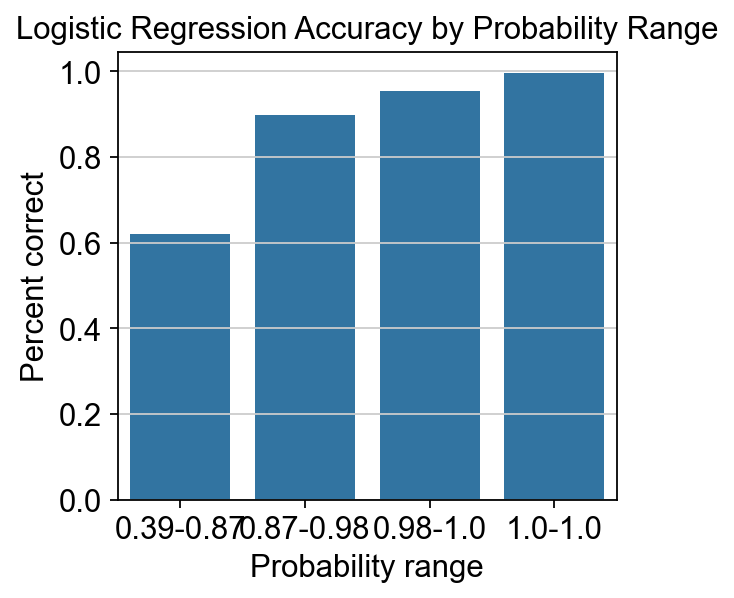

In [50]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [51]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

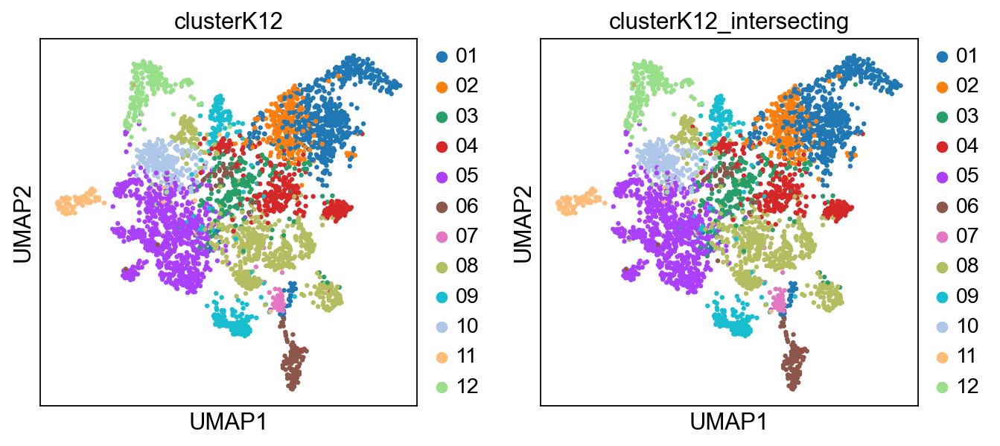

In [52]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [53]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [54]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9805555555555555

In [55]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.008654e-12,1.306505e-10,8.532869e-11,2.013731e-13,1.546765e-08,2.638176e-11,4.261765e-09,9.414558e-12,1.957403e-10,8.940808e-11,1.000000e+00,1.236686e-09,1.000000
1,12,1.516986e-10,2.140009e-11,8.125672e-11,2.129656e-09,1.989368e-09,6.487434e-07,1.450863e-08,3.525467e-08,8.239967e-08,4.411584e-07,7.614236e-09,9.999988e-01,0.999999
2,05,9.775299e-04,2.126690e-07,3.758063e-04,1.733718e-07,9.986205e-01,1.952025e-05,6.866120e-07,1.003245e-10,3.036316e-07,1.030298e-06,9.515646e-07,3.320373e-06,0.998620
3,10,5.644754e-07,4.890624e-07,5.462795e-07,1.956075e-03,7.561753e-07,9.868387e-06,6.791303e-06,1.974355e-03,8.372135e-06,9.960206e-01,4.183495e-06,1.741865e-05,0.996021
4,01,9.999970e-01,3.373491e-09,1.252904e-06,1.318399e-06,8.128567e-09,8.593041e-08,5.454971e-08,1.777208e-10,1.257888e-10,5.651178e-09,2.592221e-07,1.440691e-08,0.999997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,4.434757e-10,1.202547e-07,1.136838e-08,2.611392e-07,1.926314e-08,1.064421e-08,7.330953e-07,9.999948e-01,3.669157e-06,2.661344e-07,7.900464e-08,1.242750e-08,0.999995
3596,09,1.065823e-07,2.694162e-07,1.511369e-07,1.083432e-07,1.195217e-06,5.642972e-08,1.509251e-06,3.676681e-04,9.996246e-01,3.506204e-07,3.820771e-06,1.358341e-07,0.999625
3597,08,5.135348e-08,5.688360e-06,1.260112e-07,5.494082e-05,2.768890e-08,8.020764e-08,9.360026e-06,9.997905e-01,1.313840e-04,3.690182e-06,2.882545e-06,1.300247e-06,0.999790
3598,08,6.862033e-09,1.940602e-06,2.583824e-06,1.652409e-06,3.075110e-04,1.827337e-07,9.447666e-06,9.996459e-01,1.002162e-05,1.532753e-05,3.729541e-06,1.667447e-06,0.999646


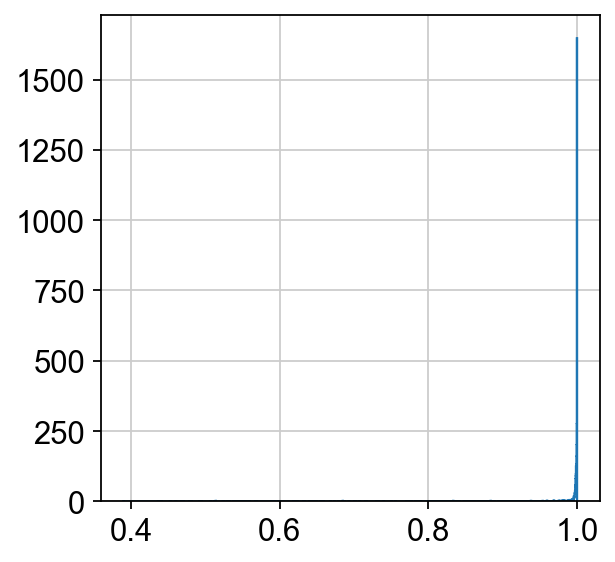

In [56]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## Check classification

In [57]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [58]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [59]:
y_pred = logreg.predict(adata_log_ordered.X)

In [60]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [61]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

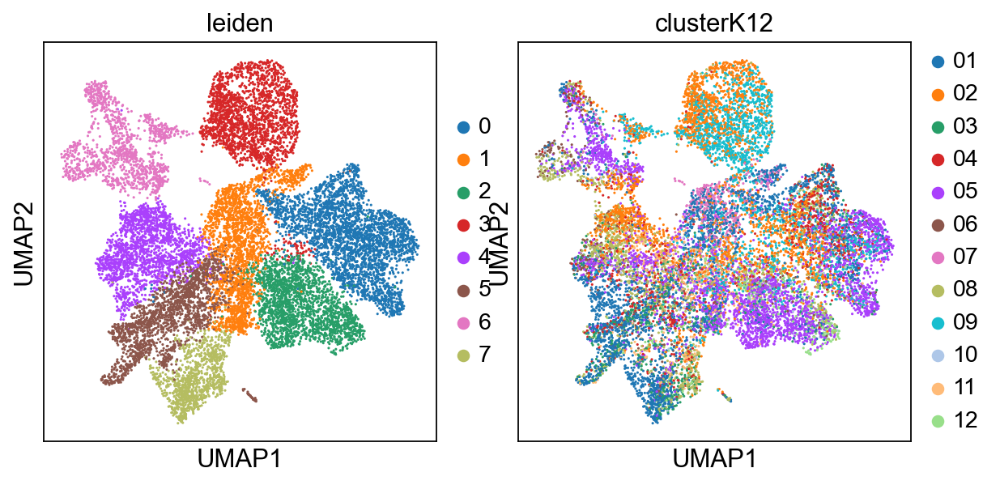

In [62]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

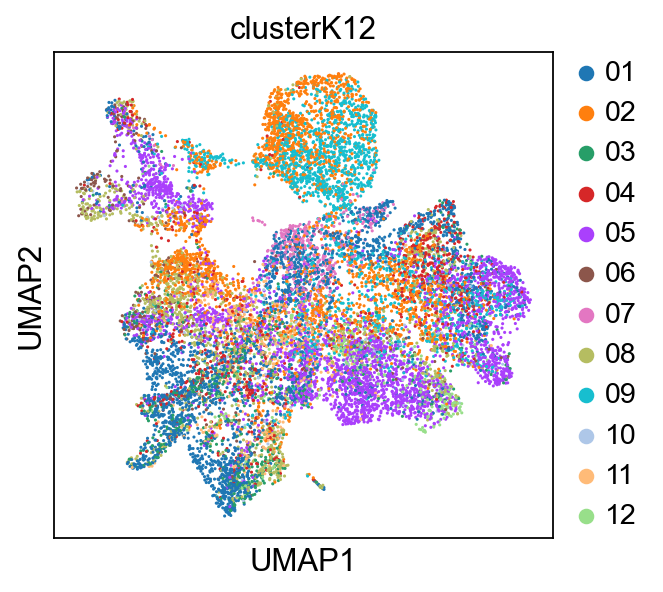

In [63]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

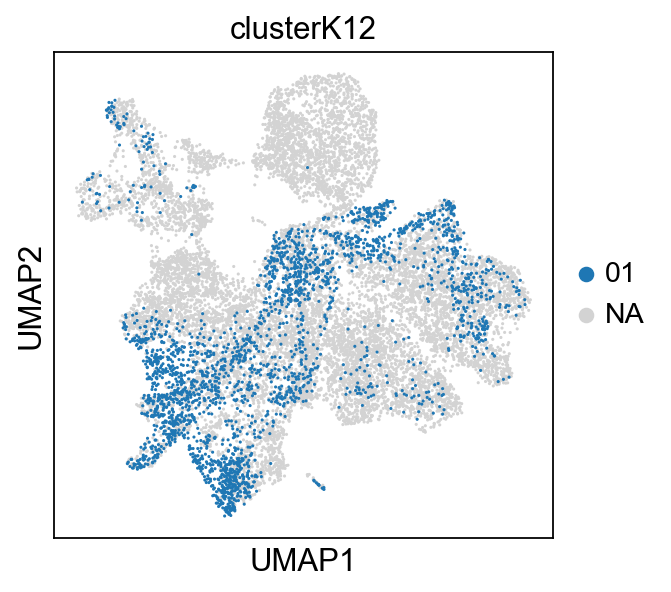

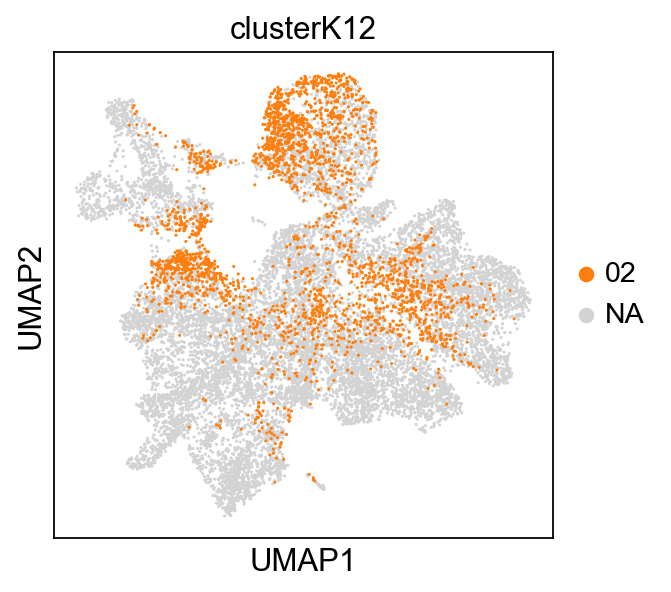

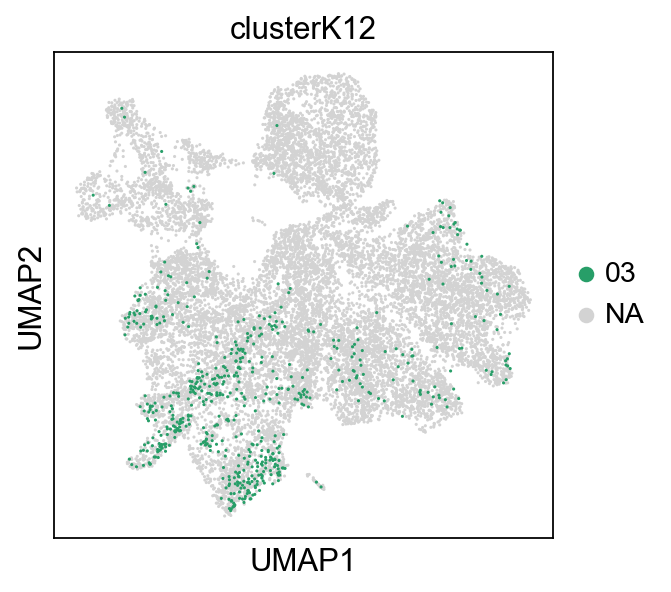

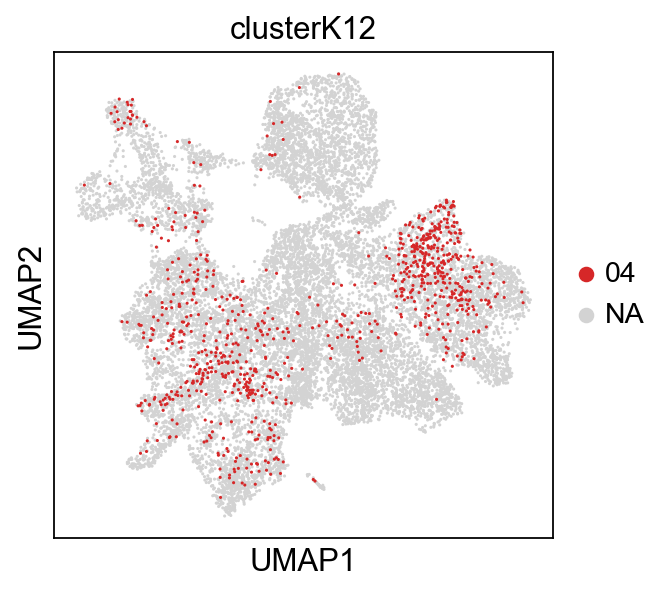

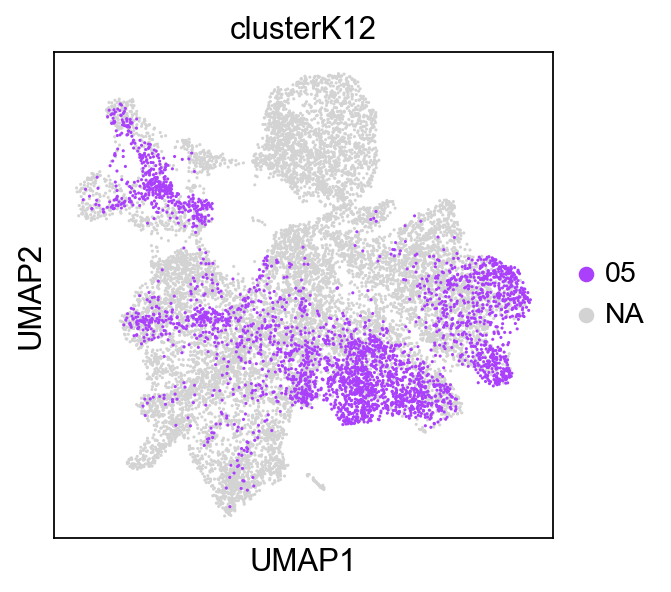

...

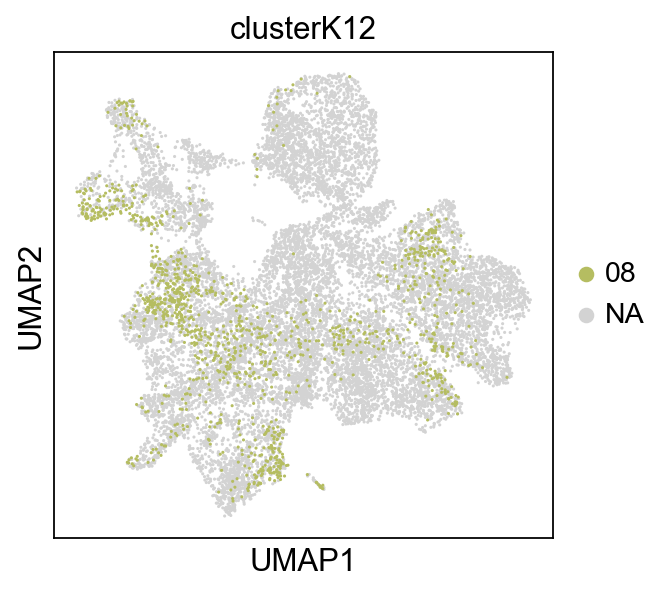

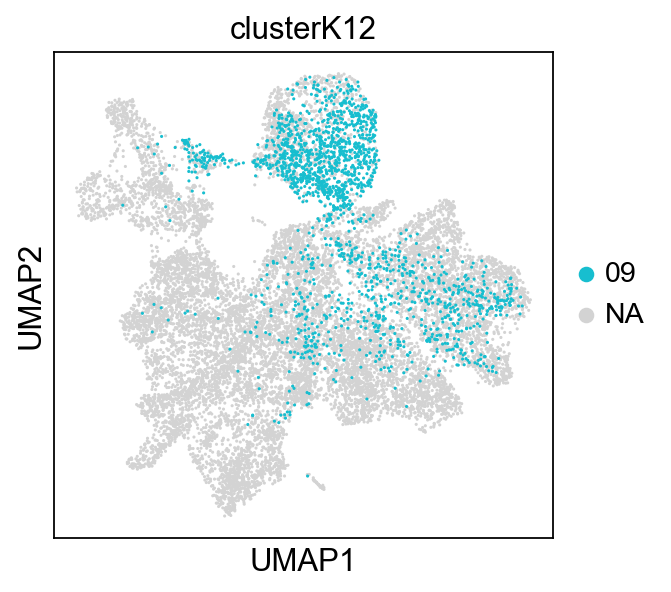

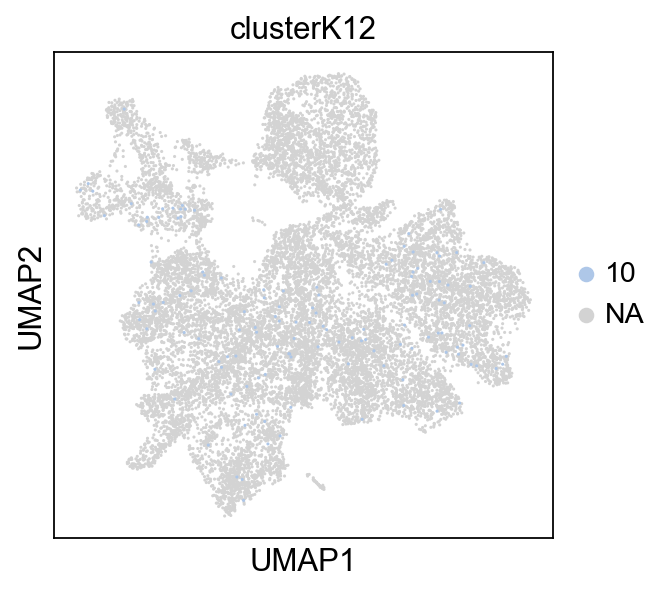

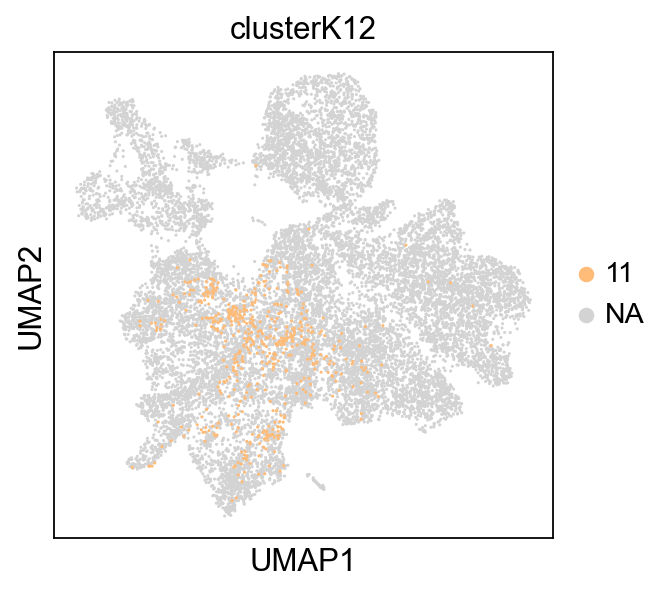

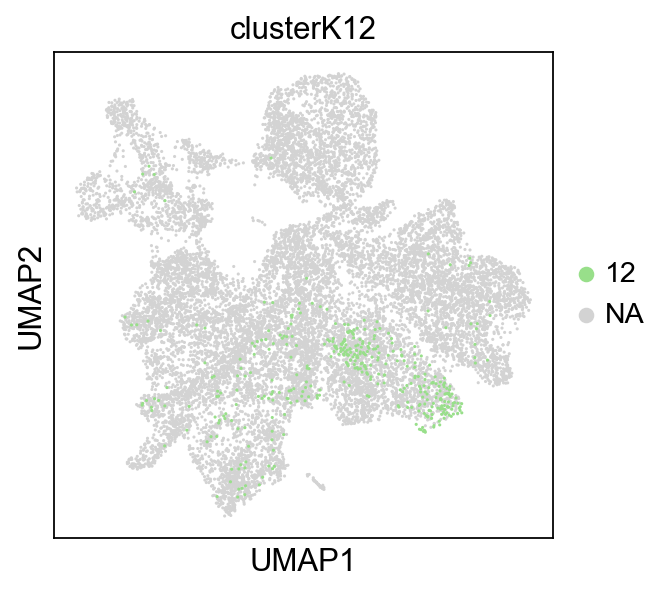

In [64]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [65]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

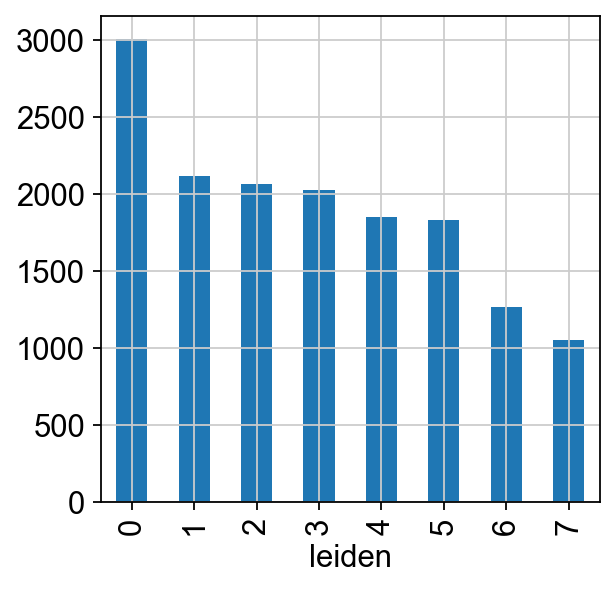

In [66]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

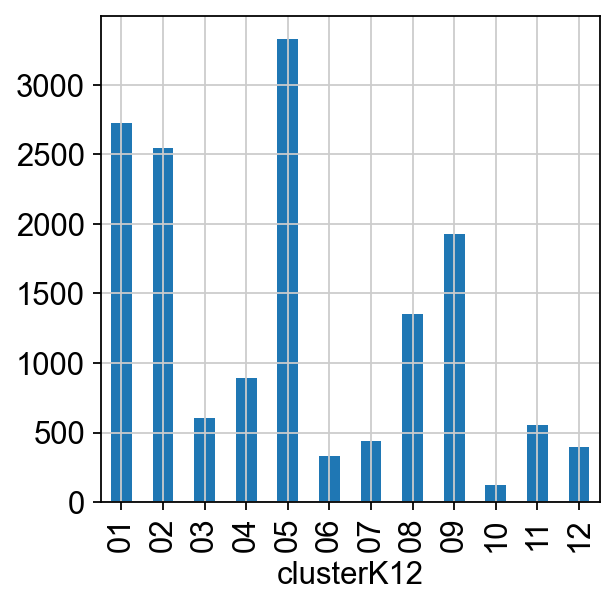

In [67]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

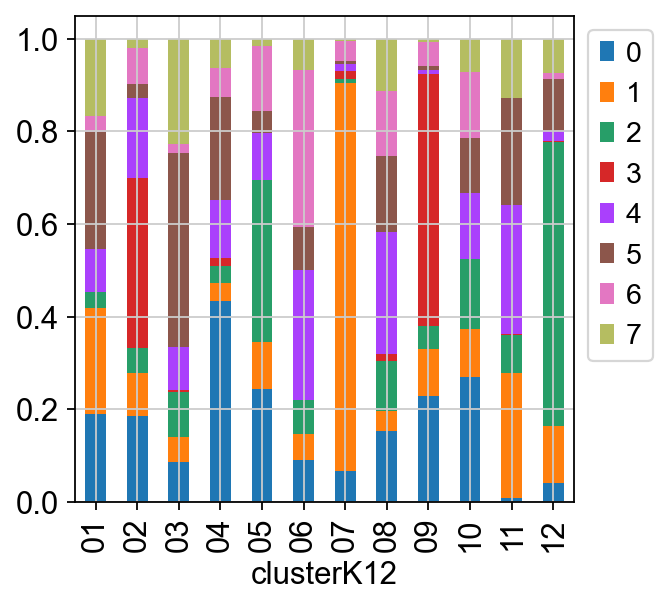

In [68]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [69]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,01,0.514743,0.000101,0.279096,0.021485,0.051323,0.004918,0.009418,0.001153,0.000431,0.016696,0.073948,0.026687,0.514743
1,02,0.019212,0.748647,0.020286,0.025764,0.003333,0.078419,0.025447,0.011511,0.034104,0.028400,0.001905,0.002970,0.748647
2,04,0.002355,0.046677,0.020346,0.316884,0.143754,0.188800,0.027108,0.193388,0.002722,0.018194,0.002813,0.036957,0.316884
3,04,0.121949,0.039059,0.007285,0.542353,0.002275,0.013171,0.016255,0.060638,0.185265,0.005150,0.004543,0.002058,0.542353
4,02,0.001254,0.262172,0.084032,0.236273,0.041308,0.198225,0.067105,0.007810,0.000655,0.046796,0.033402,0.020968,0.262172
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15221,05,0.018519,0.010345,0.132121,0.011343,0.494946,0.043583,0.023085,0.003076,0.011832,0.008746,0.077681,0.164723,0.494946
15222,06,0.000488,0.006068,0.000453,0.001580,0.015768,0.891546,0.000798,0.015103,0.011928,0.024724,0.000106,0.031438,0.891546
15223,08,0.046202,0.091877,0.043971,0.030200,0.044178,0.064416,0.084696,0.196946,0.189458,0.015683,0.180349,0.012025,0.196946
15224,09,0.202136,0.357355,0.005067,0.024828,0.000602,0.017343,0.007040,0.001267,0.372891,0.003195,0.006441,0.001835,0.372891


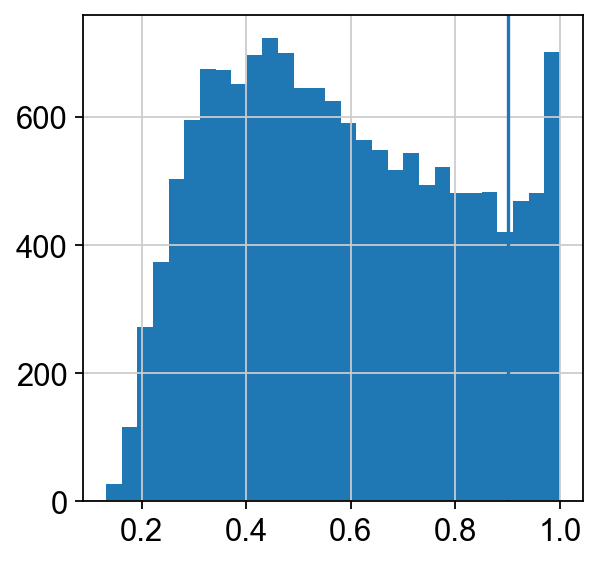

In [70]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [71]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.13-0.32,0.131,0.325
1,0.32-0.42,0.325,0.421
2,0.42-0.52,0.421,0.515
3,0.52-0.62,0.515,0.621
4,0.62-0.74,0.621,0.742
5,0.74-0.87,0.742,0.874
6,0.87-1.0,0.874,1.000


In [72]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_36880/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [73]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCAAAGTACCAGC-1-0    other
AAACCATTCTAGGCGT-1-0    other
AAACCGCTCAAGTCGC-1-0    other
AAACCGCTCCCCTTGA-1-0    other
AAACCGCTCCGTGGAT-1-0    other
                        ...  
TGTGTTGAGCGGATGA-1-1    other
TGTGTTGAGCTGGACT-1-1       06
TGTGTTGAGCTTACCT-1-1    other
TGTGTTGAGGAGGTGC-1-1    other
TGTGTTGAGTTAACCG-1-1       05
Name: clusterK12_stringent, Length: 15226, dtype: object

In [74]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

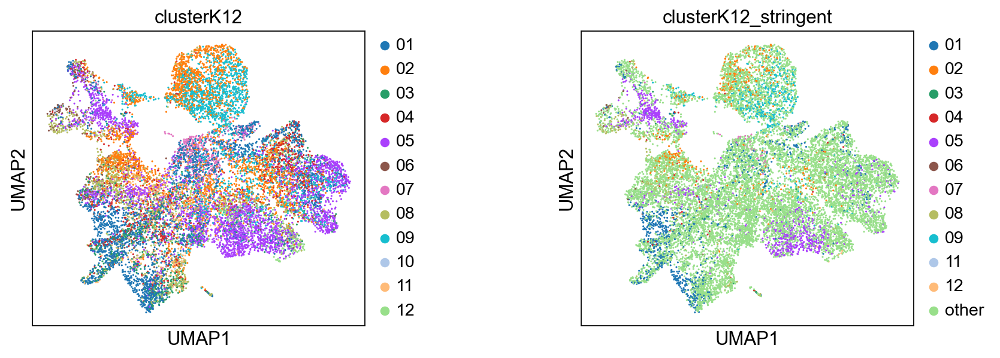

In [75]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

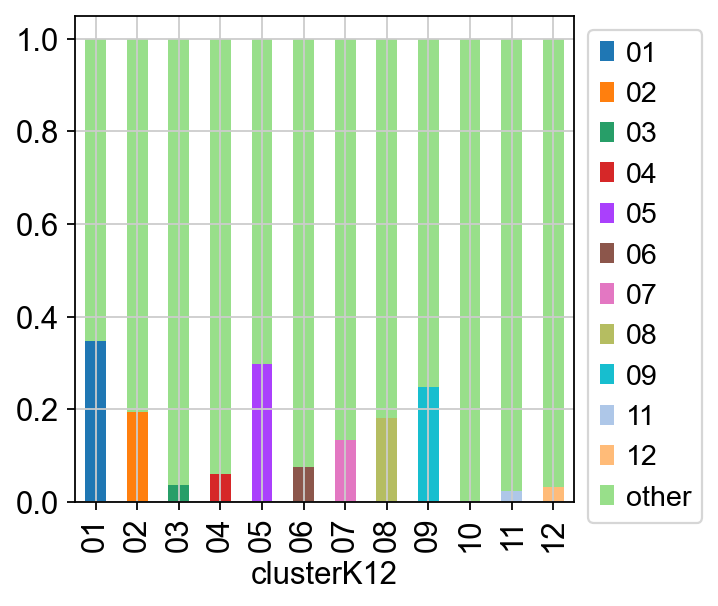

In [76]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

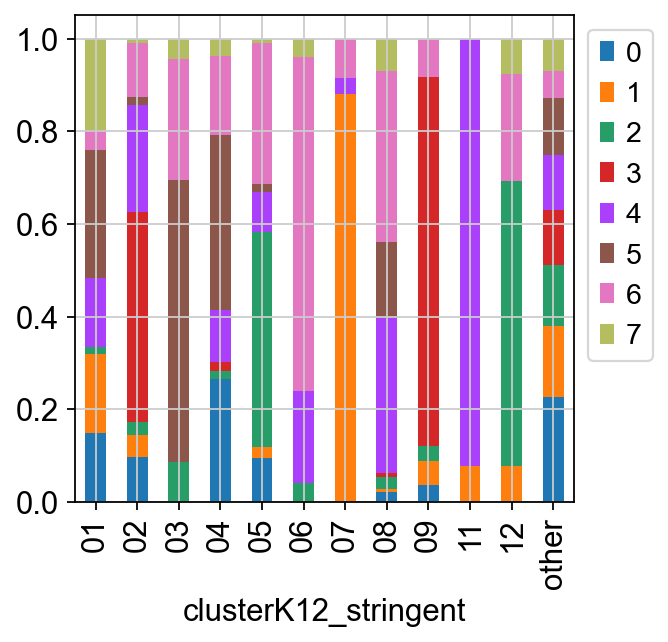

In [77]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

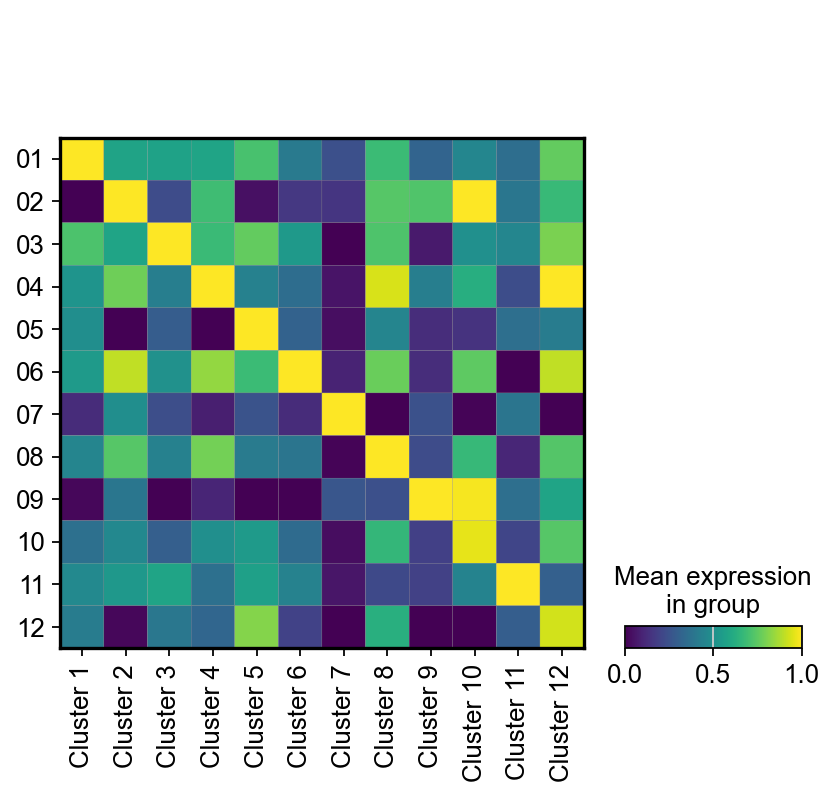

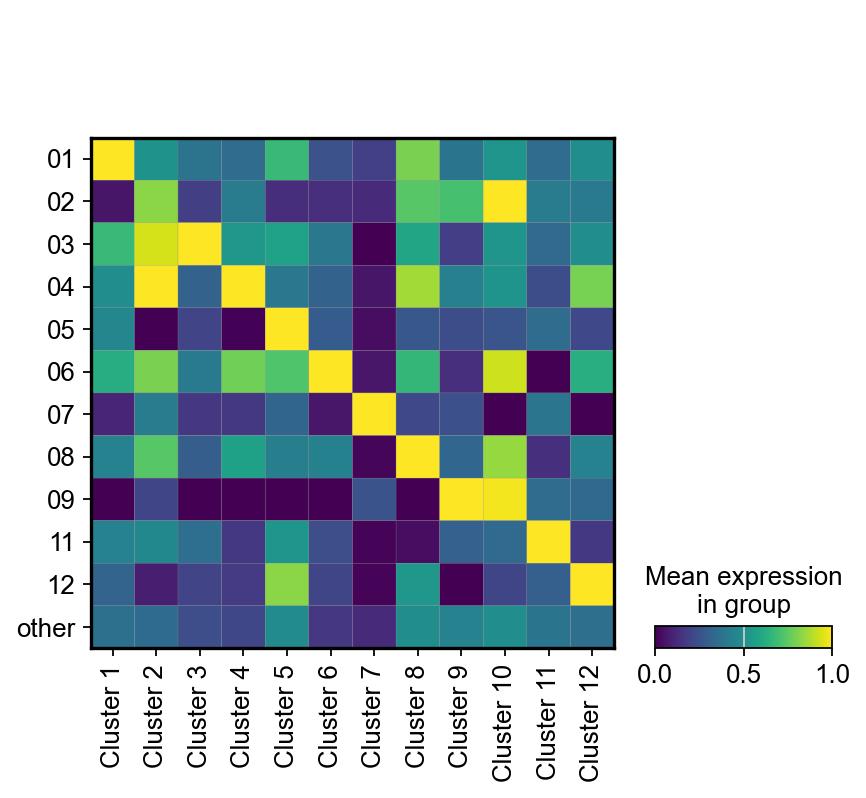

In [78]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

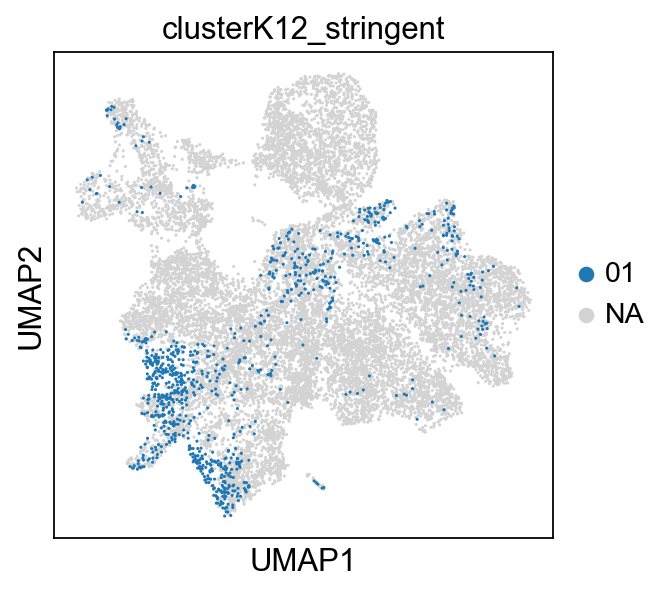

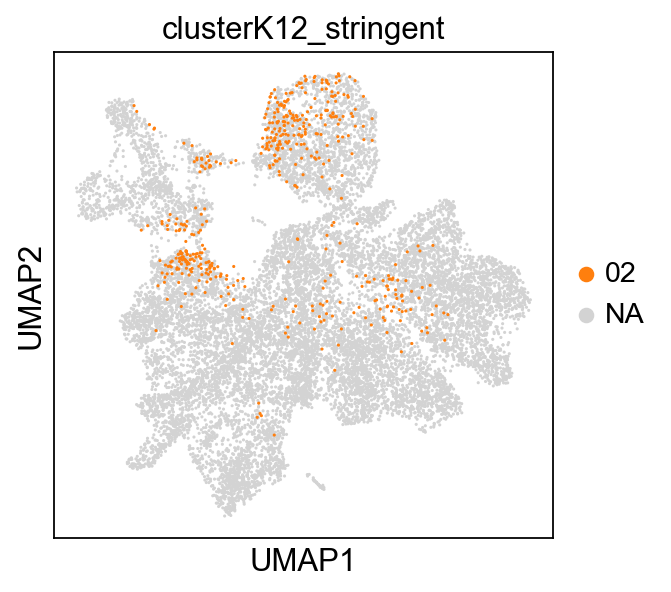

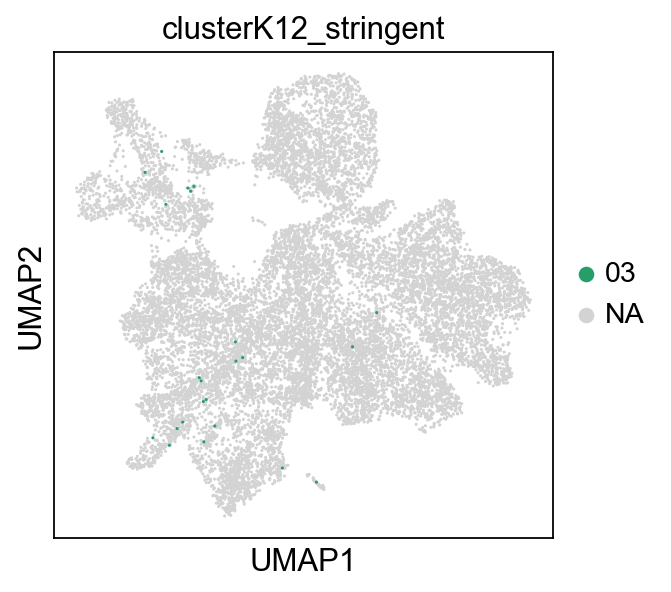

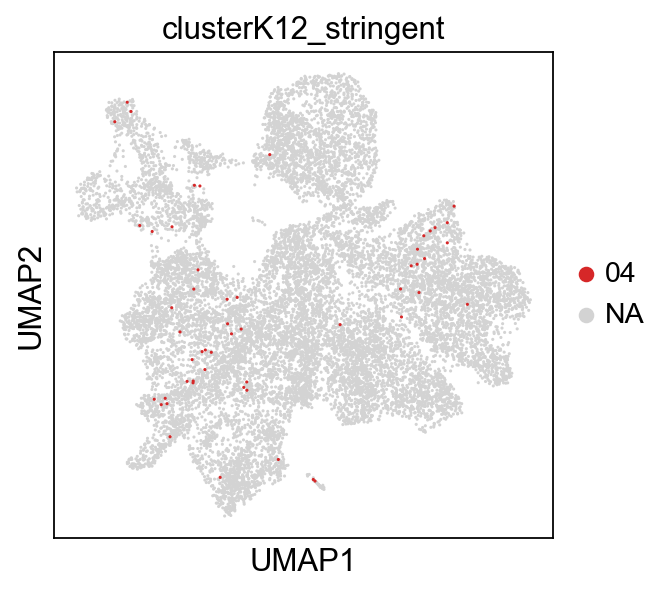

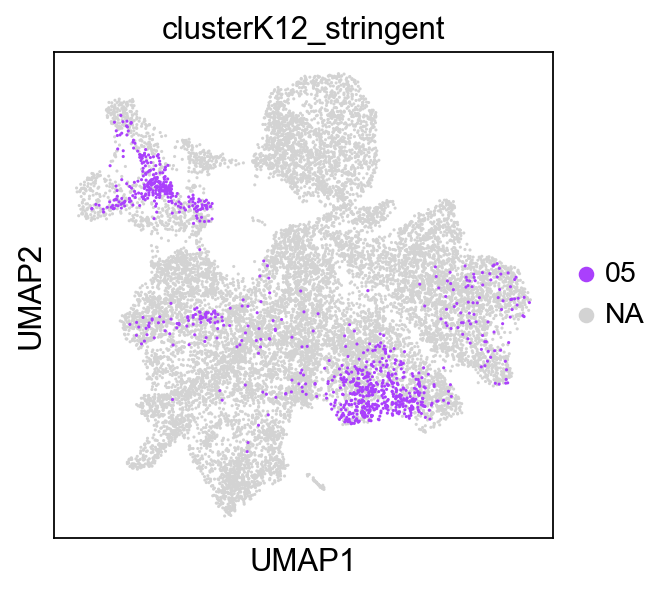

...

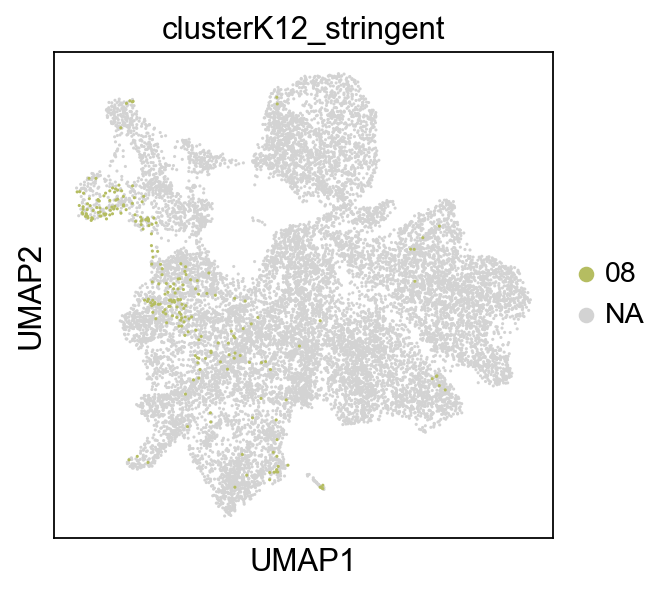

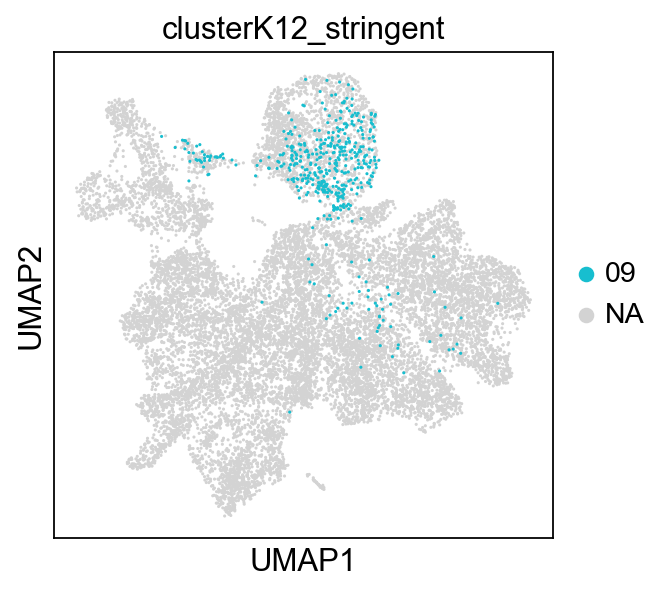

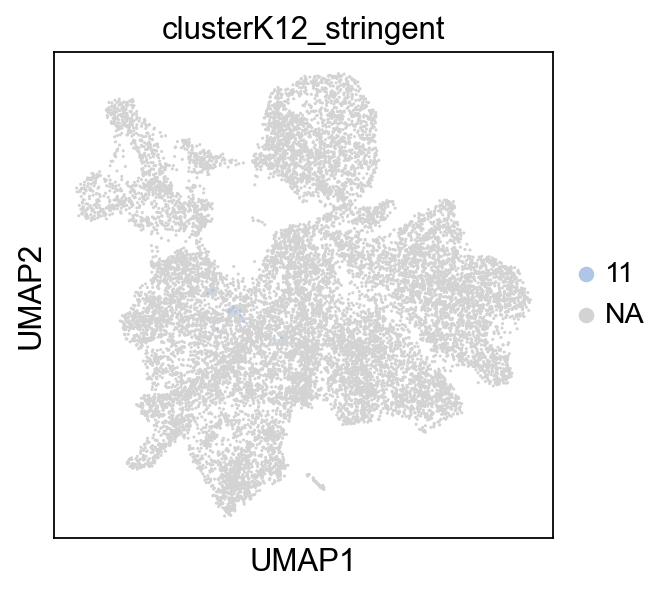

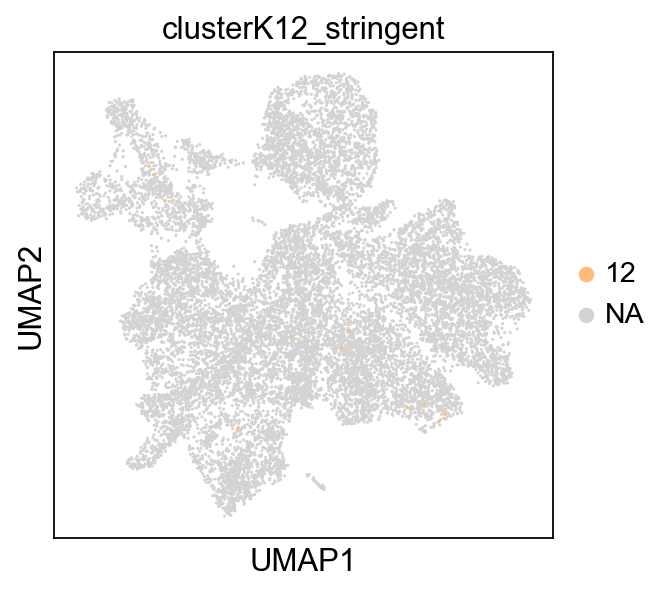

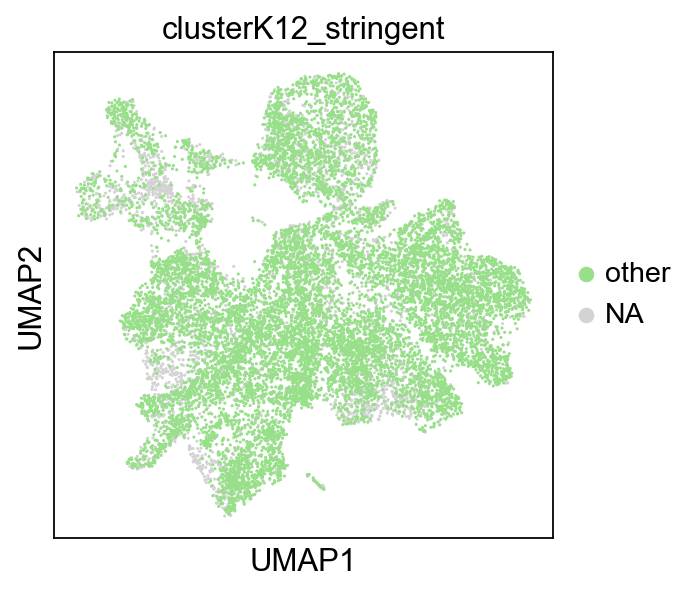

In [79]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [80]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
05    3331
01    2729
02    2545
09    1924
08    1349
04     890
03     608
11     555
07     442
12     395
06     332
10     126
Name: count, dtype: int64

In [81]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

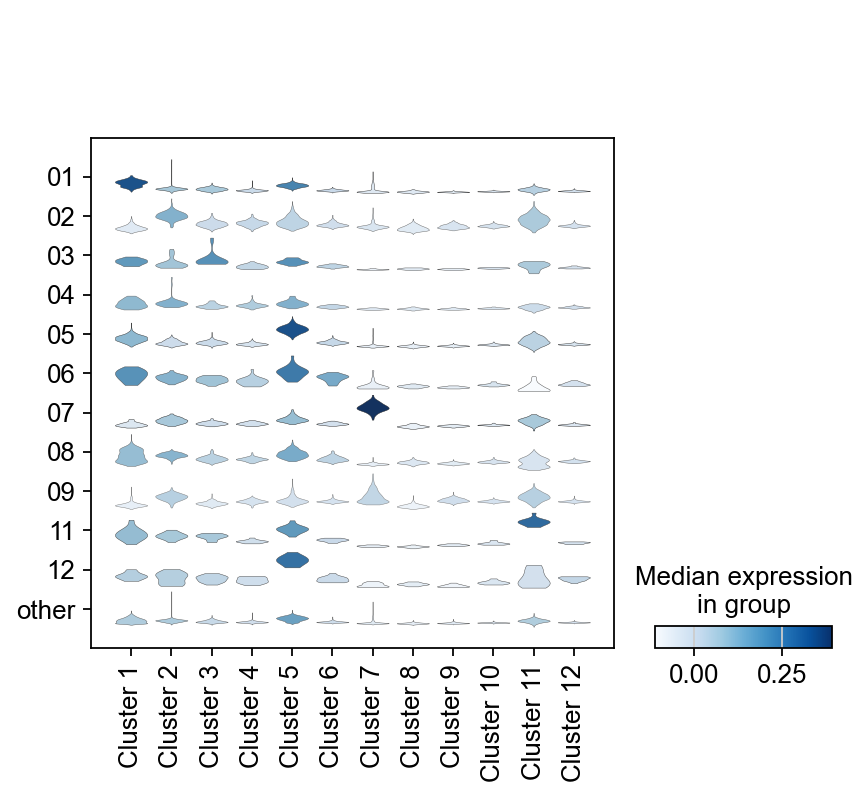

In [82]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

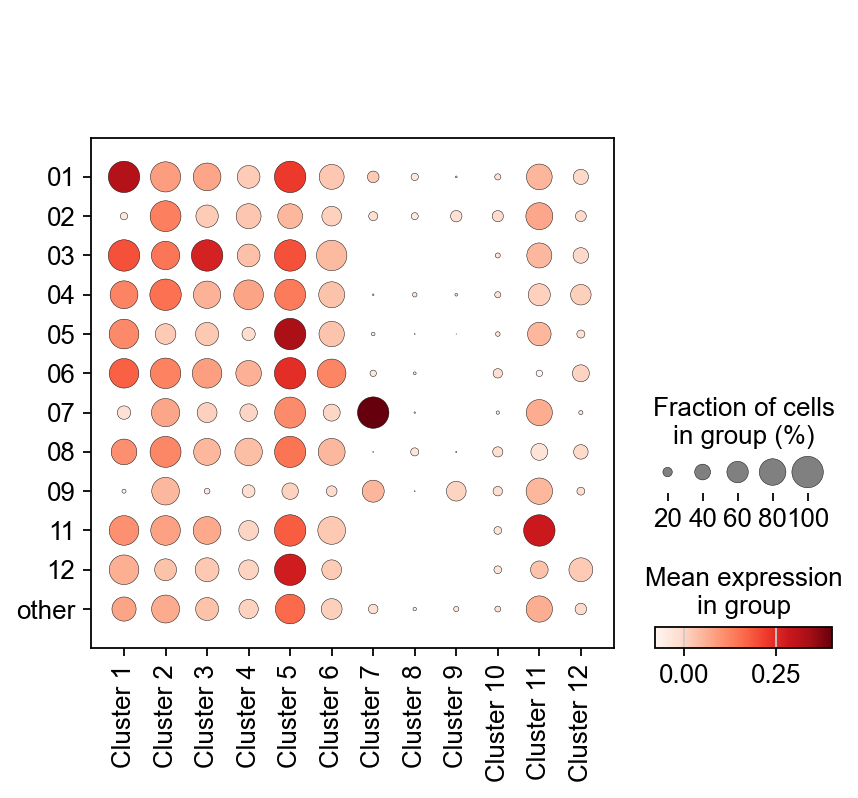

In [83]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

In [84]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

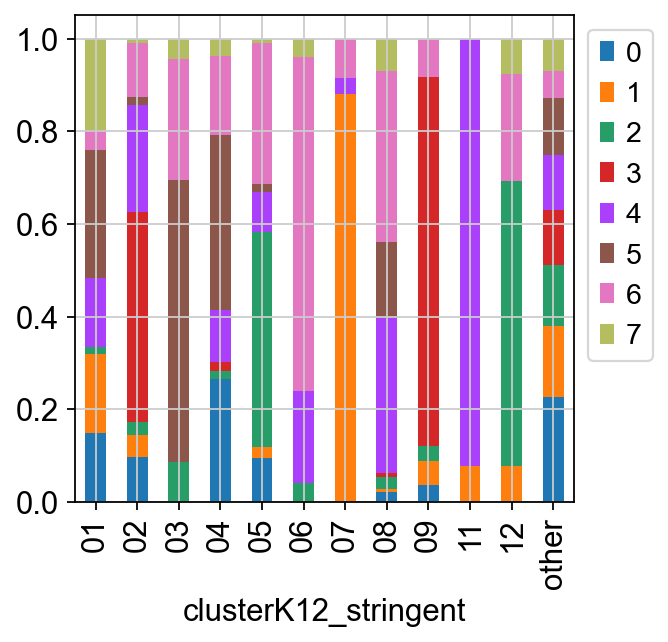

In [85]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

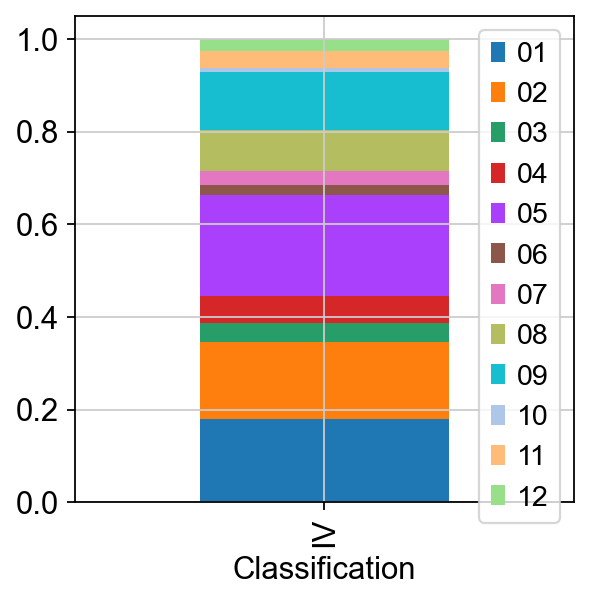

In [86]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

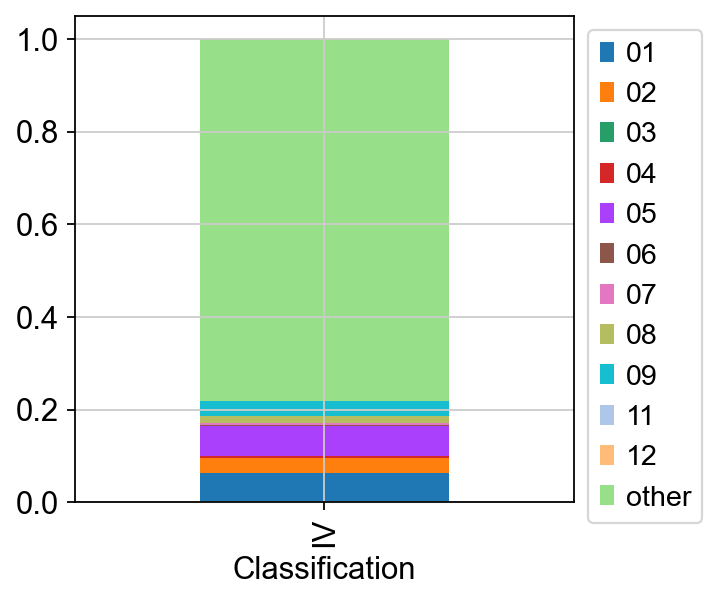

In [87]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Examine Groupings

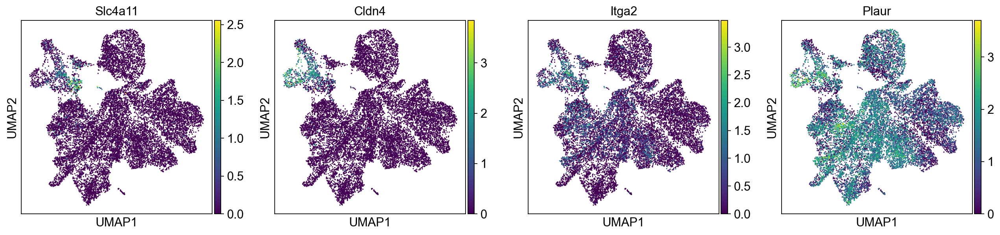

In [88]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur'])

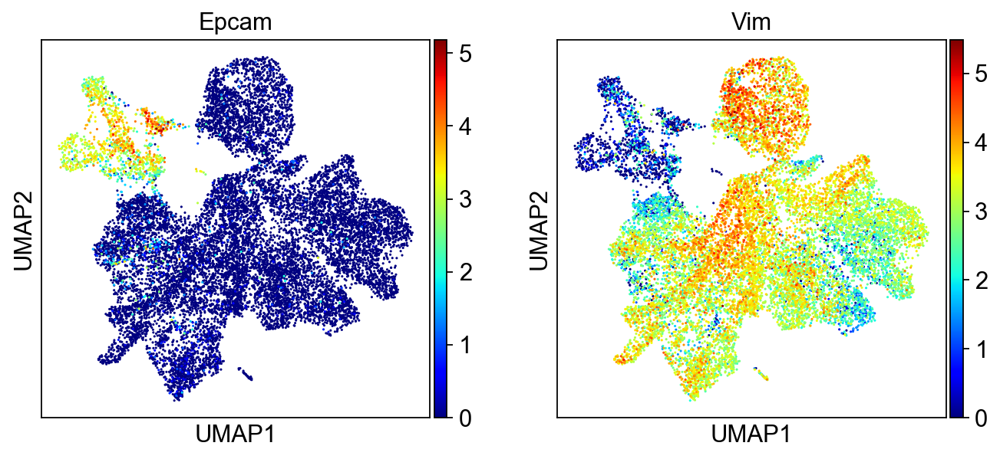

In [89]:
sc.pl.umap(adata, color=['Epcam','Vim',], cmap="jet") #'Cd109'

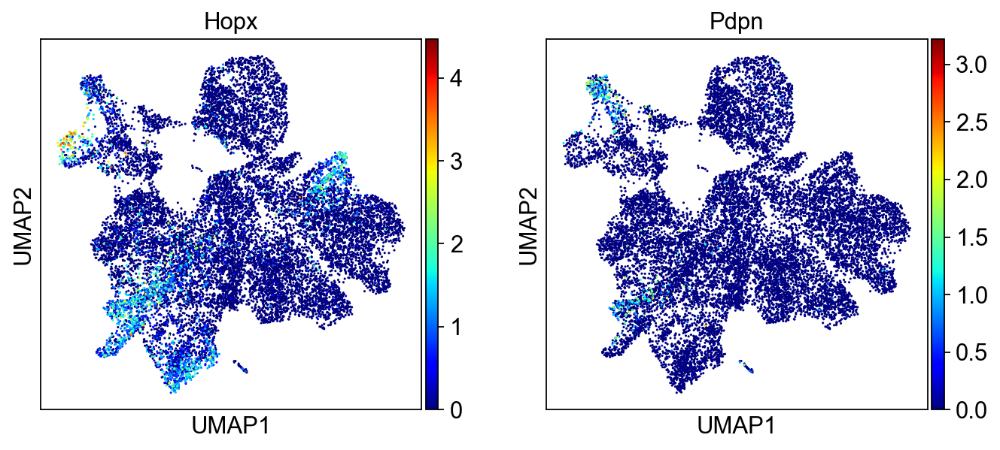

In [90]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

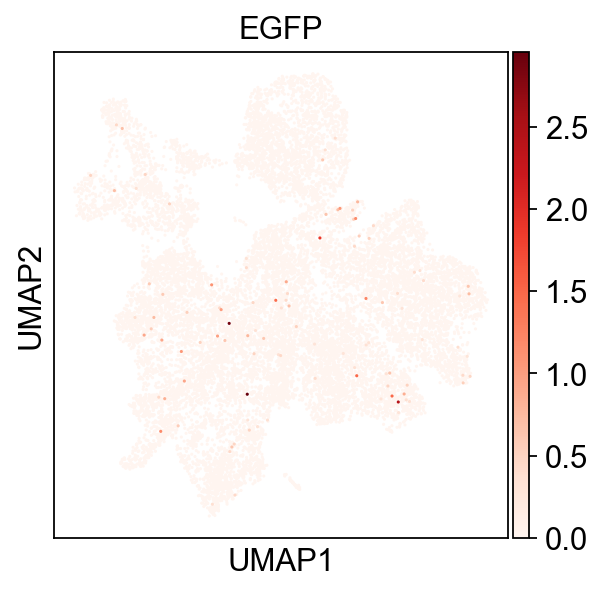

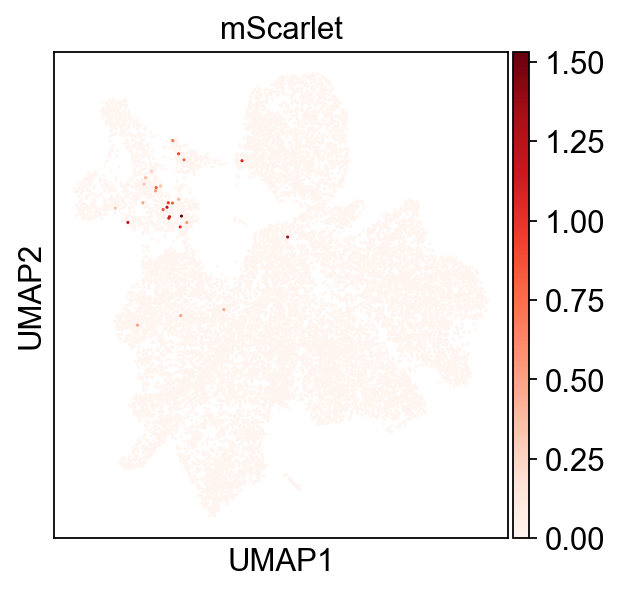

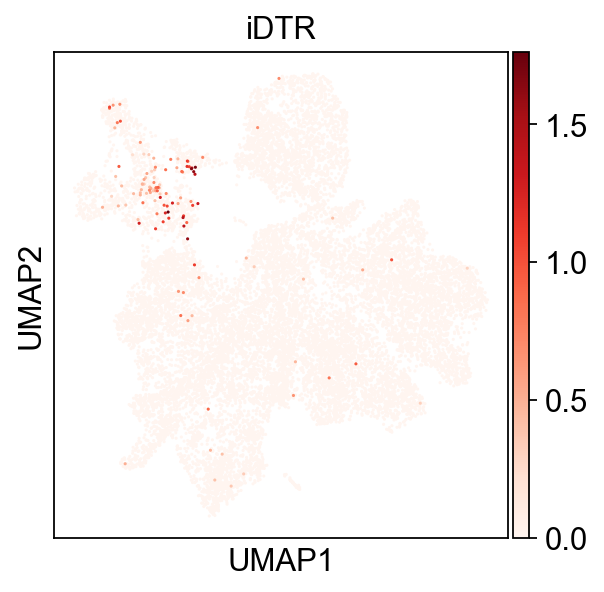

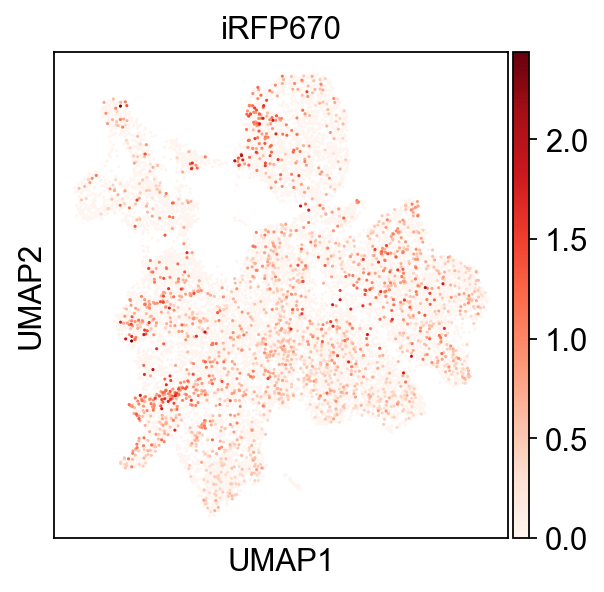

In [91]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['mScarlet'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')
sc.pl.umap(adata, color=['iRFP670'], cmap='Reds')
#sc.pl.umap(adata, color=['Akaluc'], cmap='Reds')

In [92]:
sc.tl.embedding_density(adata,basis='umap', groupby='batch')

computing density on 'umap'
--> added
    'umap_density_batch', densities (adata.obs)
    'umap_density_batch_params', parameter (adata.uns)


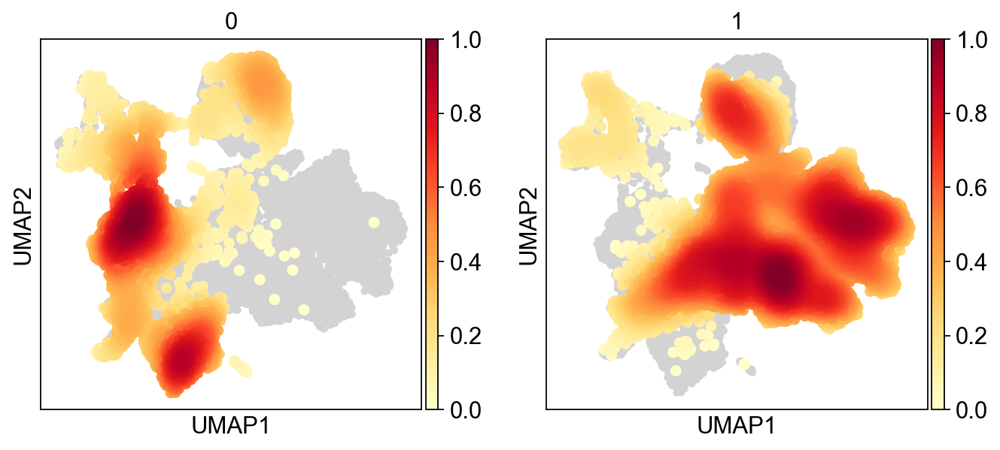

In [93]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_batch')

In [94]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


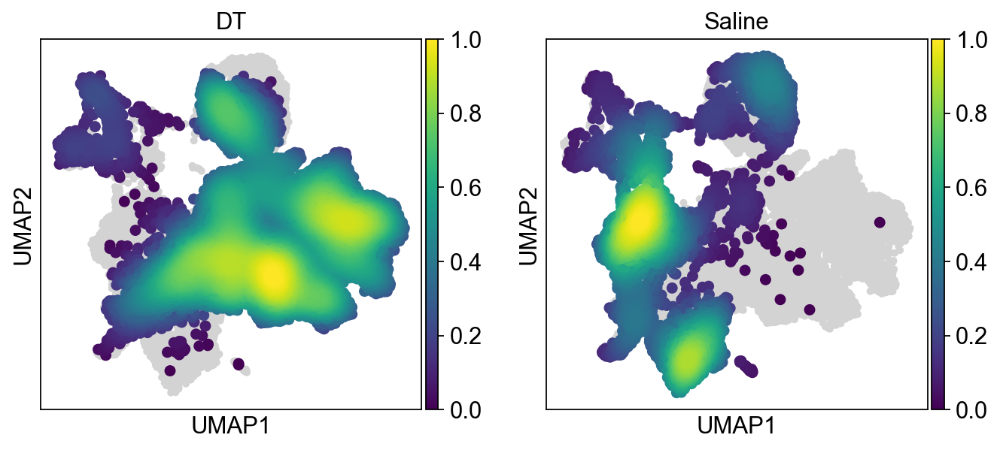

In [95]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group',color_map='viridis')

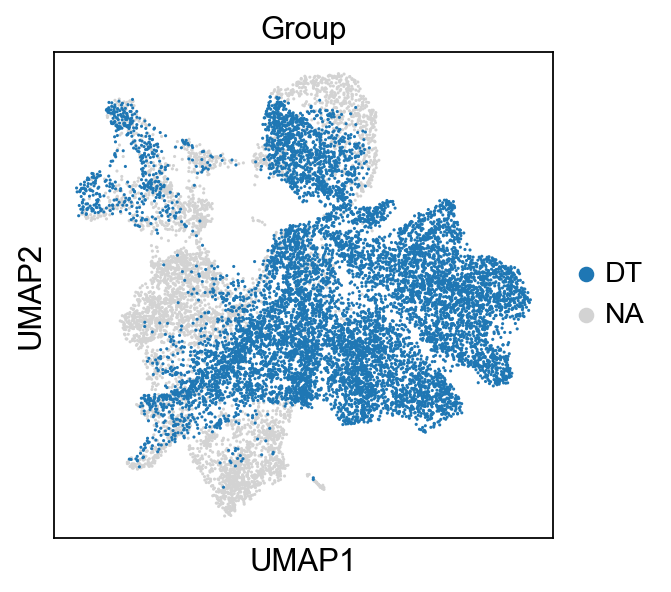

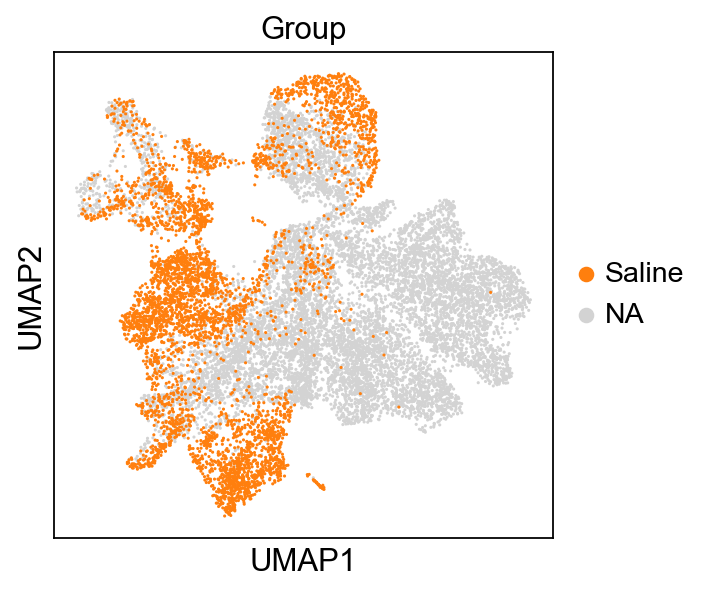

In [96]:
for x in adata.obs.Group.cat.categories:
    sc.pl.umap(adata, color='Group', groups=[x])

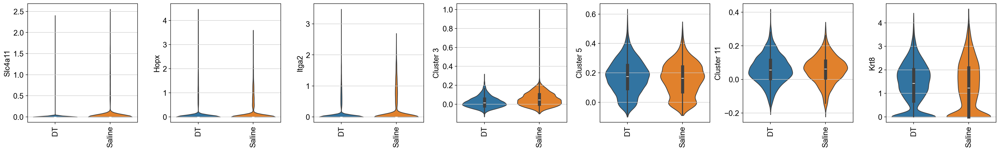

In [97]:
sc.pl.violin(adata, ['Slc4a11','Hopx','Itga2','Cluster 3','Cluster 5','Cluster 11','Krt8'], 
             groupby='Group',rotation=90,inner='box',stripplot=False)

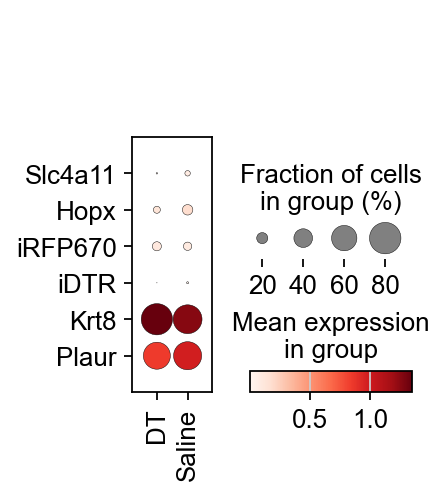

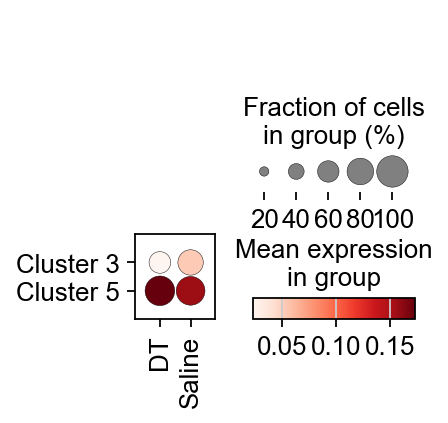

In [98]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx','iRFP670','iDTR','Krt8','Plaur'], groupby='Group',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5'], groupby='Group',swap_axes=True)

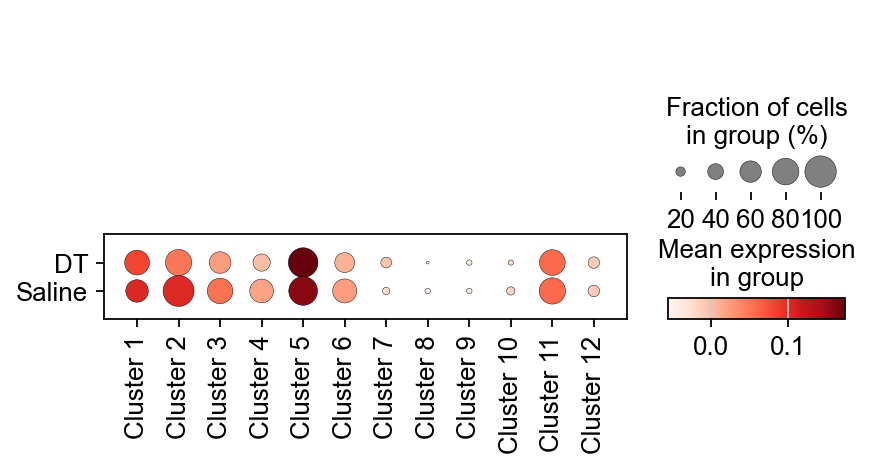

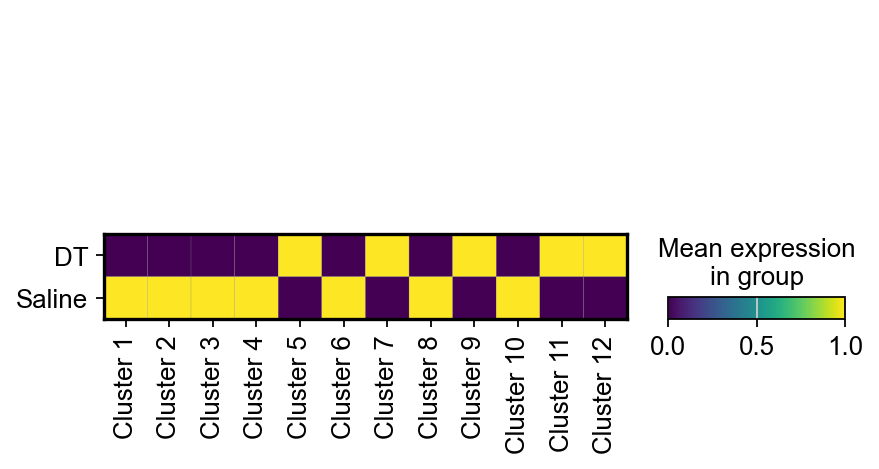

In [99]:
sc.pl.dotplot(adata, [*cancerCell], groupby='Group',swap_axes=False)
sc.pl.matrixplot(adata, [*cancerCell], groupby='Group',swap_axes=False,standard_scale='var')

In [100]:
del adata.uns['leiden_colors']

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


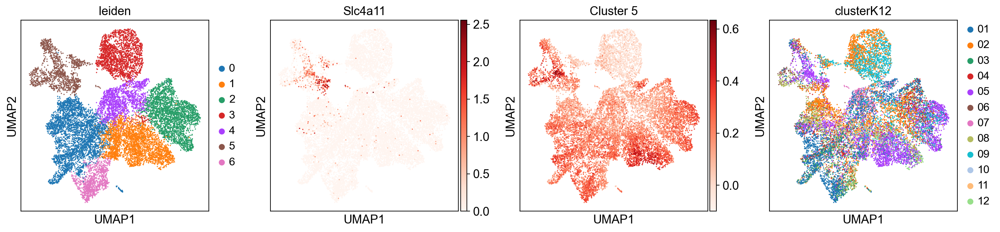

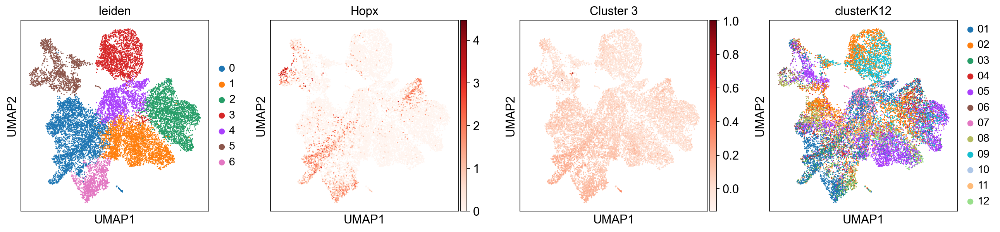

In [101]:
sc.tl.leiden(adata, resolution=.15)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5', 'clusterK12'], cmap='Reds')
sc.pl.umap(adata, color=['leiden','Hopx','Cluster 3', 'clusterK12'], cmap='Reds')

In [102]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="leiden", method="wilcoxon")


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)


    using 'X_pca' with n_pcs = 150
Storing dendrogram info using `.uns['dendrogram_leiden']`


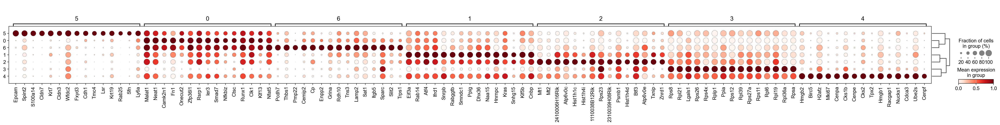

In [103]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden", standard_scale="var", n_genes=15
)

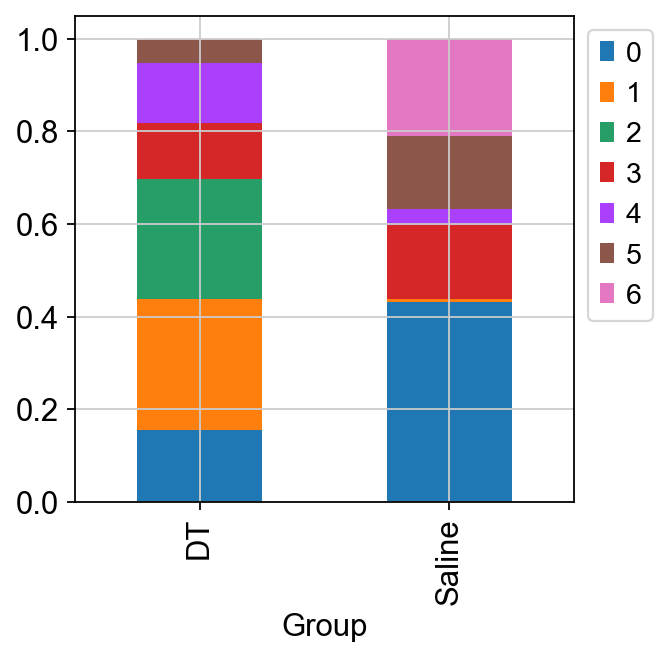

In [104]:
cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

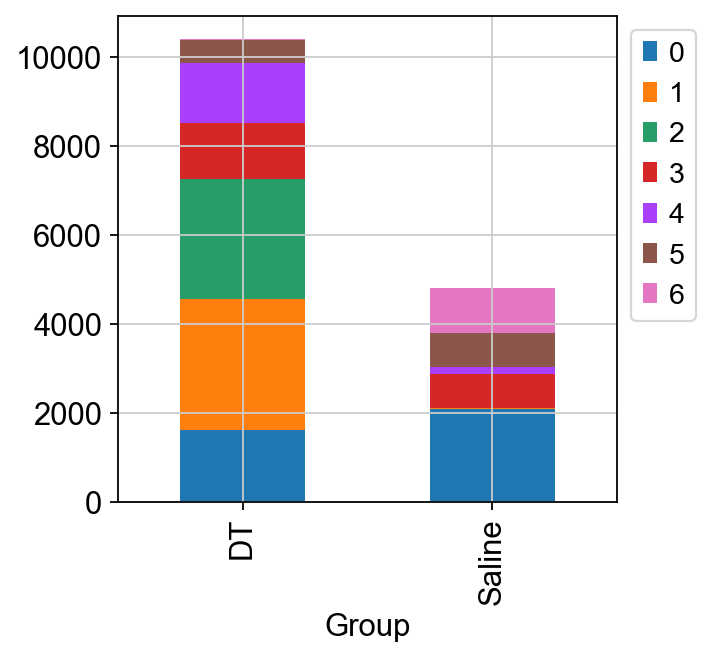

In [105]:
cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata.obs['Group']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [106]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="leiden", method="wilcoxon")


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)


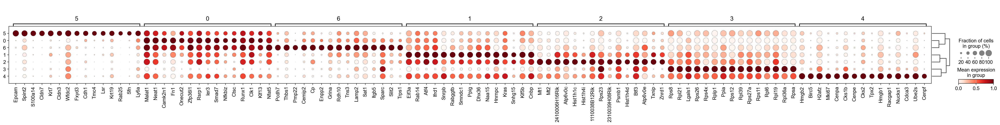

In [107]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden", standard_scale="var", n_genes=15
)

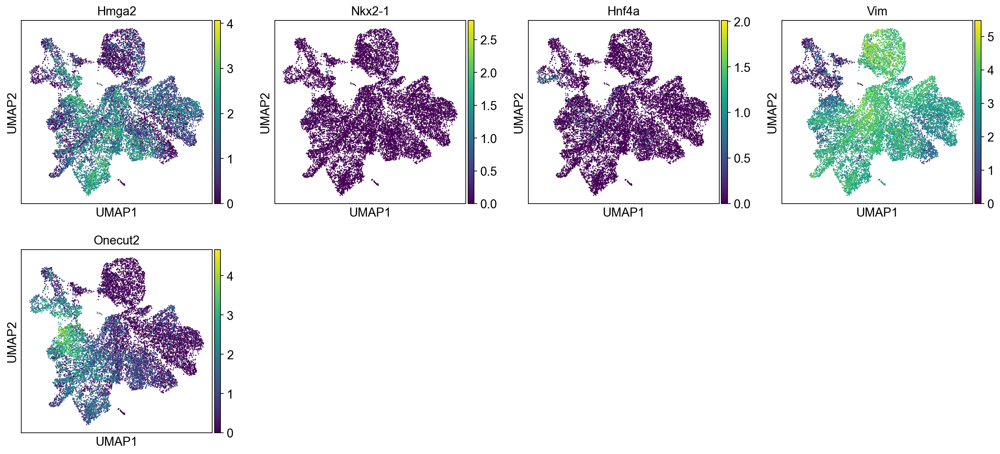

In [108]:
sc.pl.umap(adata, color=['Hmga2','Nkx2-1','Hnf4a','Vim','Onecut2'])

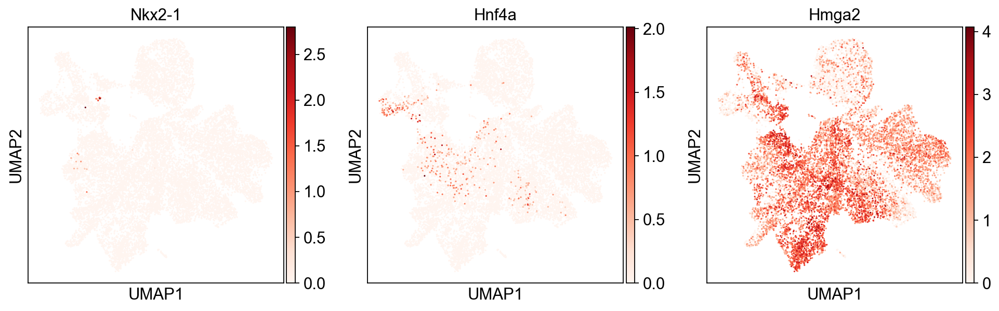

In [109]:
sc.pl.umap(adata, color=['Nkx2-1','Hnf4a','Hmga2'],cmap='Reds')

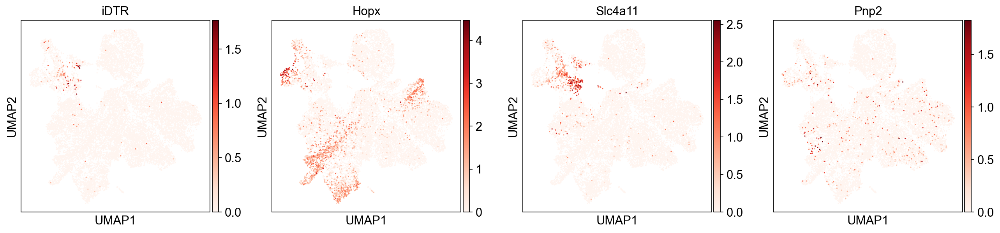

In [110]:
sc.pl.umap(adata, color=['iDTR','Hopx','Slc4a11','Pnp2'],cmap='Reds')

## Calculate PV

In [111]:
#Phenotypic Volume
def calcPV(matrix):
    gene_cov = np.cov(matrix.T)
    mat = pd.DataFrame(gene_cov)
    eig_vals = np.linalg.eigvalsh(mat)
    return(sum(np.log2(eig_vals[eig_vals > 0])))

In [112]:
repeats = 1000

In [113]:
adata.obs.Group.value_counts(sort=False)

Group
DT        10411
Saline     4815
Name: count, dtype: int64

In [114]:
matrix = adata[adata.obs['Group'].isin(['Saline']),adata.var['highly_variable']].X.copy()
dist3 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist3.append(calcPV(matrix[sample_id]))

In [115]:
matrix = adata[adata.obs['Group'].isin(['DT']),adata.var['highly_variable']].X.copy()
dist4 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist4.append(calcPV(matrix[sample_id]))

In [116]:
matrix = adata[np.logical_and(adata.obs['Group'].isin(['Saline']),np.logical_not(adata.obs['leiden'].isin(['5']))),adata.var['highly_variable']].X.copy()
dist5 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist5.append(calcPV(matrix[sample_id]))

In [117]:
matrix = adata[np.logical_and(adata.obs['Group'].isin(['Saline']),np.logical_not(adata.obs['leiden'].isin(['4']))),adata.var['highly_variable']].X.copy()
dist6 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist6.append(calcPV(matrix[sample_id]))

In [118]:
matrix = adata[np.logical_and(adata.obs['Group'].isin(['Saline']),np.logical_not(adata.obs['leiden'].isin(['6']))),adata.var['highly_variable']].X.copy()
dist7 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist7.append(calcPV(matrix[sample_id]))

In [119]:
matrix = adata[np.logical_and(adata.obs['Group'].isin(['Saline']),np.logical_not(adata.obs['leiden'].isin(['2']))),adata.var['highly_variable']].X.copy()
dist8 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist8.append(calcPV(matrix[sample_id]))

In [120]:
matrix = adata[np.logical_and(adata.obs['Group'].isin(['Saline']),np.logical_not(adata.obs['leiden'].isin(['0']))),adata.var['highly_variable']].X.copy()
dist9 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist9.append(calcPV(matrix[sample_id]))

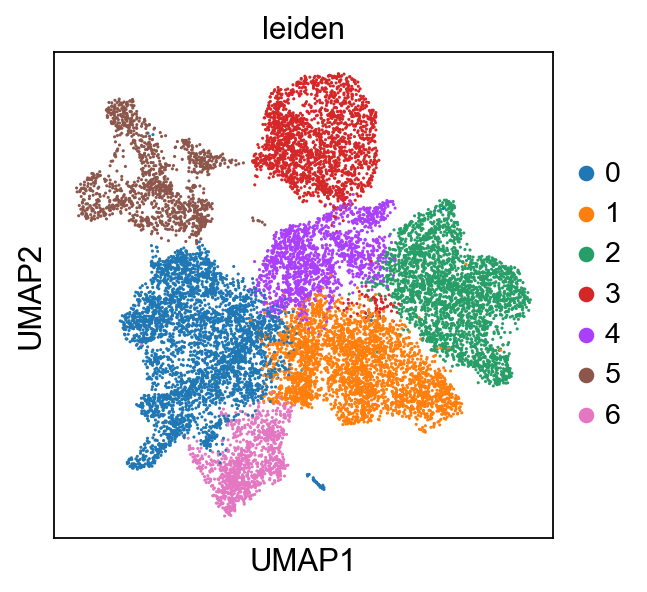

In [121]:
sc.pl.umap(adata, color='leiden')

In [122]:
adata[adata.obs['Group'].isin(['Saline']), adata.var['highly_variable']].obs.leiden.value_counts(normalize=True)

leiden
0    0.431776
6    0.211007
3    0.159917
5    0.157632
4    0.033645
1    0.005815
2    0.000208
Name: proportion, dtype: float64

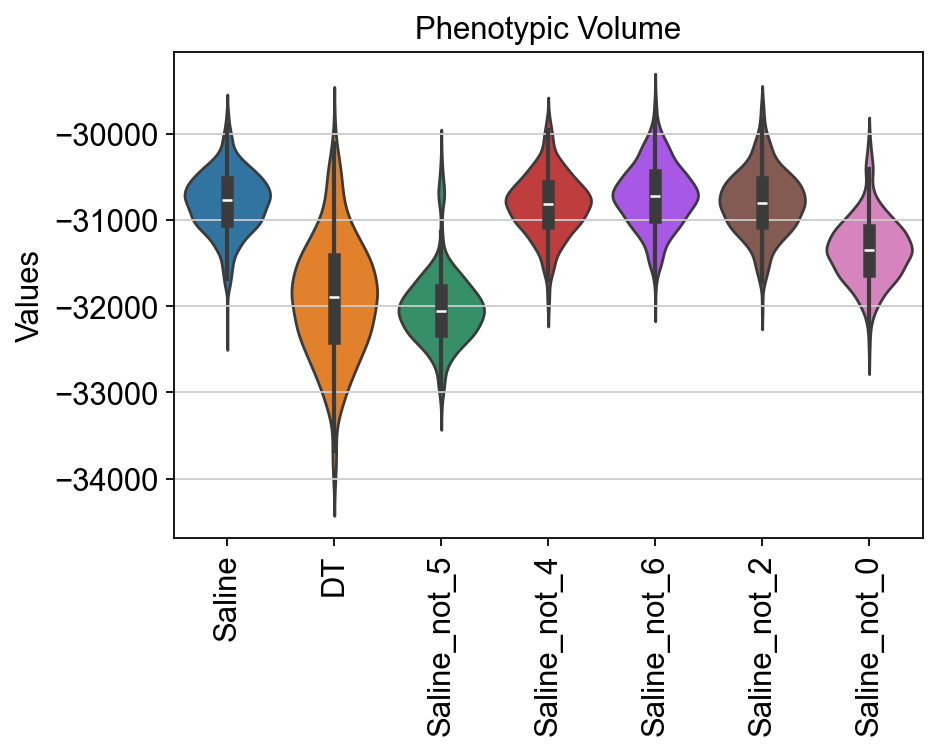

In [123]:
data = [dist3, dist4, dist5, dist6, dist7, dist8, dist9]
labels = ["Saline", "DT", "Saline_not_5", "Saline_not_4", "Saline_not_6", "Saline_not_2", "Saline_not_0"]

# Create violin plot using Seaborn
plt.figure(figsize=(6, 4))
sns.violinplot(data=data)
plt.xticks(ticks=[0, 1,2,3,4,5,6], labels=labels, rotation=90)
plt.ylabel("Values")
plt.title("Phenotypic Volume")
plt.show()

In [124]:
pd.DataFrame(np.column_stack((dist3, dist4,dist5, dist6, dist7, dist8)),columns=['Saline','DT', "Saline_not_5", "Saline_not_4", "Saline_not_6", "Saline_not_2"]).to_excel('Ext_Data_Fig9n_PV.xlsx')